# Topic: M33's Stream Dynamics
by Alondra Cardona

The purpose of this project is to look at the tidal debris in the form of stellar streams around M33 during the MW-M31 merger. This project will delve into the dynamical and kinematic evolution of M33's disk stars as a result of the gravitational phenomena experienced from its host galaxy merging with another galaxy similar in size. 

In [ ]:
# import modules
import numpy as np
import astropy.units as u
from astropy.constants import G

# import plotting modules
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.colors import LogNorm

# my modules from class
from ReadFile import Read
from ParticleProperties import ParticleInfo
from CenterOfMass2 import CenterOfMass
from OrbitCOM import OrbitCOM
from MassProfile import MassProfile
from GalaxyMass import ComponentMass

# Step 1: Define necessary functions

In [ ]:
def RotateFrame(posI,velI):
    """a function that will rotate the position and velocity vectors
    so that the disk angular momentum is aligned with z axis. From Lab 9.
    
    PARAMETERS
    ----------
        posI : `array of floats`
             3D array of positions (x,y,z)
        velI : `array of floats`
             3D array of velocities (vx,vy,vz)
             
    RETURNS
    -------
        pos: `array of floats`
            rotated 3D array of positions (x,y,z) 
            such that disk is in the XY plane
        vel: `array of floats`
            rotated 3D array of velocities (vx,vy,vz) 
            such that disk angular momentum vector
            is in the +z direction 
    """
    
    # compute the angular momentum
    L = np.sum(np.cross(posI,velI), axis=0)
    
    # normalize the angular momentum vector
    L_norm = L/np.sqrt(np.sum(L**2))


    # Set up rotation matrix to map L_norm to
    # z unit vector (disk in xy-plane)
    
    # z unit vector
    z_norm = np.array([0, 0, 1])
    
    # cross product between L and z
    vv = np.cross(L_norm, z_norm)
    s = np.sqrt(np.sum(vv**2))
    
    # dot product between L and z 
    c = np.dot(L_norm, z_norm)
    
    # rotation matrix
    I = np.array([[1, 0, 0], [0, 1, 0], [0, 0, 1]])
    v_x = np.array([[0, -vv[2], vv[1]], [vv[2], 0, -vv[0]], [-vv[1], vv[0], 0]])
    R = I + v_x + np.dot(v_x, v_x)*(1 - c)/s**2

    # Rotate coordinate system
    pos = np.dot(R, posI.T).T
    vel = np.dot(R, velI.T).T

    return pos, vel


In [29]:
# COM instance of M33
def Positions2D(M33file):
    """a function that will calculate the distances and velocities of 
    all disk particles at any given frame. From Lab 9.
    
    PARAMETERS
    ----------
        M33file: file where all the simulation 
                particle data is stored for a 
                specific time frame

    RETURNS
    -------
        rn : `array of floats`
             rotated 3D array of positions (x,y,z) 
             such that disk is in the XY plane
        vn : `array of floats`
             rotated 3D array of velocities (x,y,z) 
             such that disk is in the XY plane
        dist: 'array of floats'
             array of distance vector magnitudes
             of all disk particles relative to 
             galaxy center of mass
        vel: 'array of floats'
             array of velocity vector magnitudes
             of all disk particles relative to 
             galaxy center of mass
        t : 'float'
             time of simulation frame in Gyr
    """
    
    COMM33 = CenterOfMass(M33file,2)
    
    # Compute COM of M33 using disk particles
    COMP_33 = COMM33.COM_P(0.1,4)
    COMV_33 = COMM33.COM_V(COMP_33[0],COMP_33[1],COMP_33[2])

    # time
    t = (COMM33.time).value/1000

    # Determine positions of disk particles relative to M31 COM 
    xD = COMM33.x - COMP_33[0].value 
    yD = COMM33.y - COMP_33[1].value 
    zD = COMM33.z - COMP_33[2].value 
    
    # Determine velocities of disk particles relative to COM motion
    vxD = COMM33.vx - COMV_33[0].value 
    vyD = COMM33.vy - COMV_33[1].value 
    vzD = COMM33.vz - COMV_33[2].value 
    
    # Arrays for r and v 
    r = np.array([xD,yD,zD]).T # transposed 
    v = np.array([vxD,vyD,vzD]).T

    # compute the rotated position and velocity vectors
    rn, vn = RotateFrame(r,v)

    vel = np.sqrt(v[:,0]**2+v[:,1]**2+v[:,2]**2)
    dist = np.sqrt(r[:,0]**2+r[:,1]**2+r[:,2]**2)
    
    return rn, vn, dist, vel, t



In [ ]:
def Totmass(filename):
    '''
    Function that computes the total mass of
    any given galaxy. Original function.

    INPUTS:
    -------
        filename: 'string'
                  name of file for any
                  given time frame
    
    OUTPUT:
    -------
        M : 'float'
            total mass of galaxy 
    '''
    
    bulge = ComponentMass(filename,3)*1e12 # bulge 
    disk = ComponentMass(filename,2)*1e12 # disk 
    halo = ComponentMass(filename,1)*1e12 #dark matter

    # total mass
    M = bulge+disk+halo
    
    return M
        

We are insterested in the stellar streams, composed of particles at a distance of or above M33's Jacobi radius
\begin{equation}
    R_j = r  \bigg( \frac{M_{sat}}{2 M_{host}(<r)} \bigg)^{1/3}
\end{equation}

In [ ]:
def JacobiR(Mhost, Msat, r):
    '''
    Function that computes the Jacobi radius of a
    satellite around a host galaxy. Original function.
    
    INPUTS:
    -------
        Mhost = 'float', mass of host galaxy in solar masses
        Msat = 'float', mass of satellite galaxy in solar masses
        r = 'float', semi major axis of the satellite's orbit around the primary in kpc
        m = mass of a test particle in solar masses
        
    OUTPUTS:
    --------
        Rj = 'float', Jacobi radius in kpc

    '''
    a = Msat**(1/3) 
    b = (2*Mhost)**(1/3)

    Rj = r*(a/b)

    return Rj
    

# Step 2: Make plots of M33 disk particles for movie
Plots show disk particles color coded by velocity magnitude, a red arrow that points to M31's center of mass, a circle centered at M33's center of mass with radius of M33's Jacobi radius, and the time of each frame in Gyr

In [48]:
# array of timeteps in the simulation
tsteps = np.arange(0,600,4)

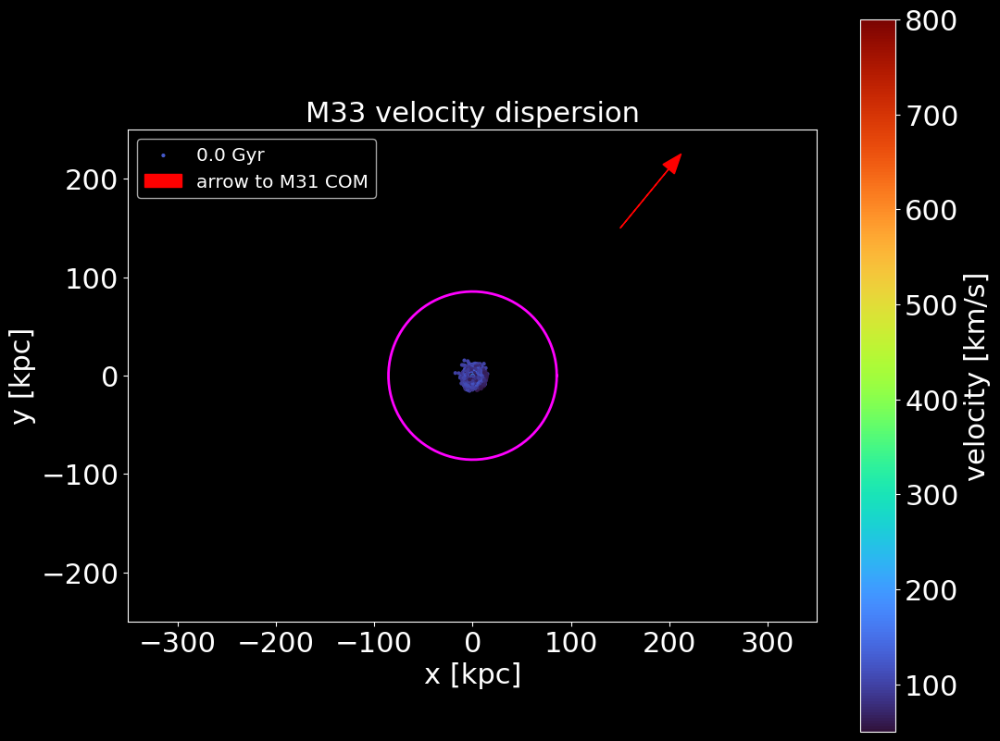

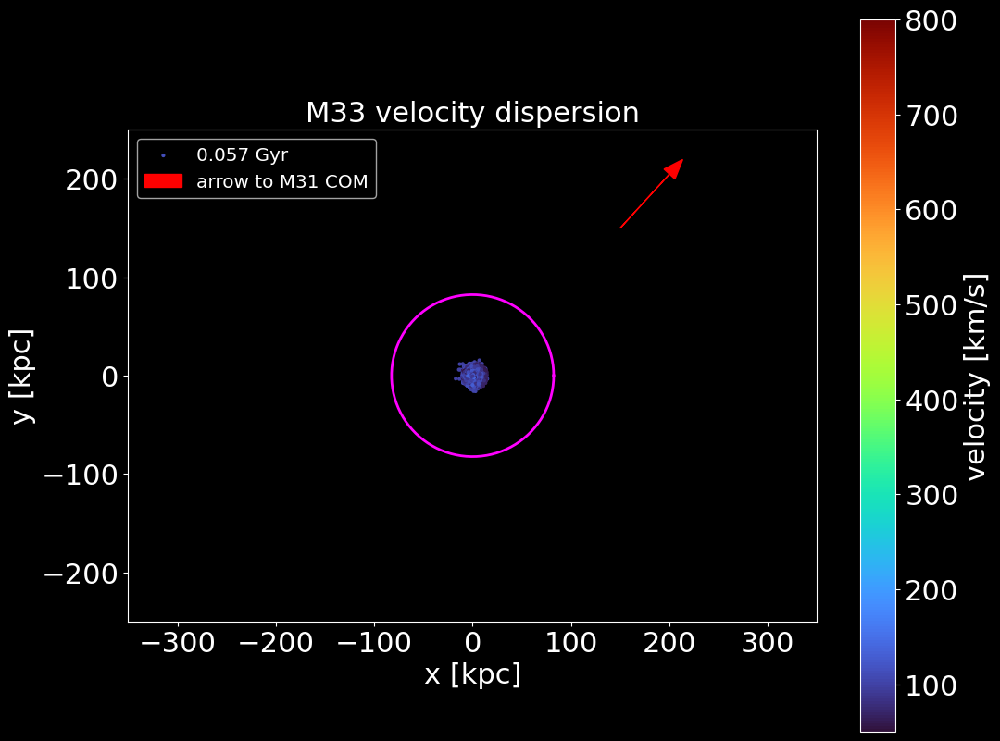

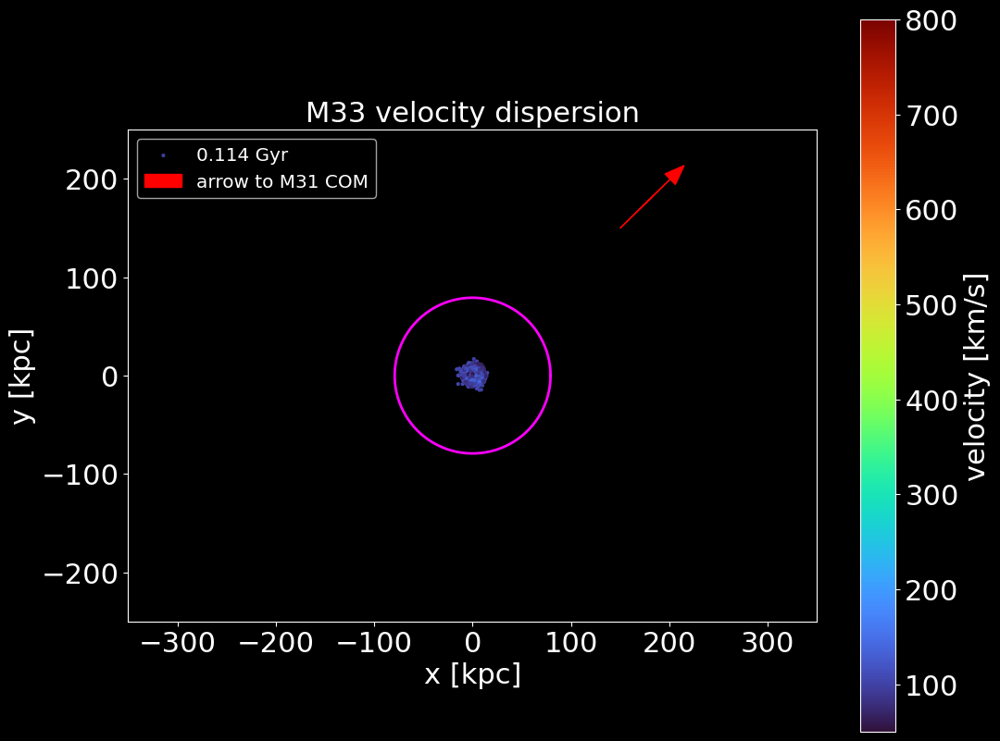

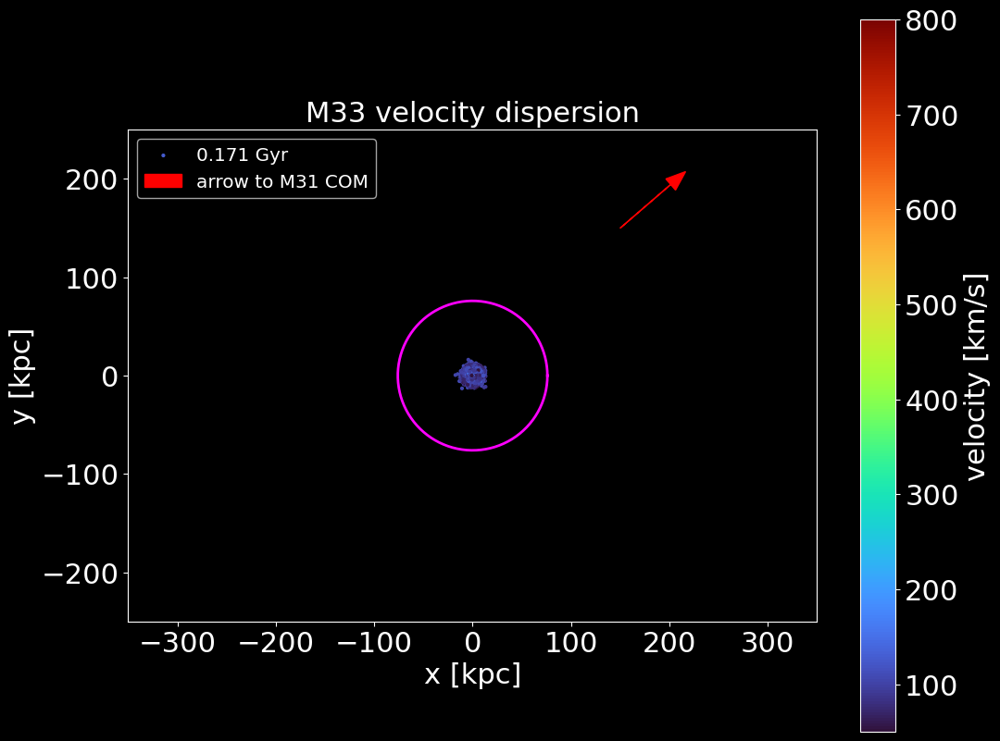

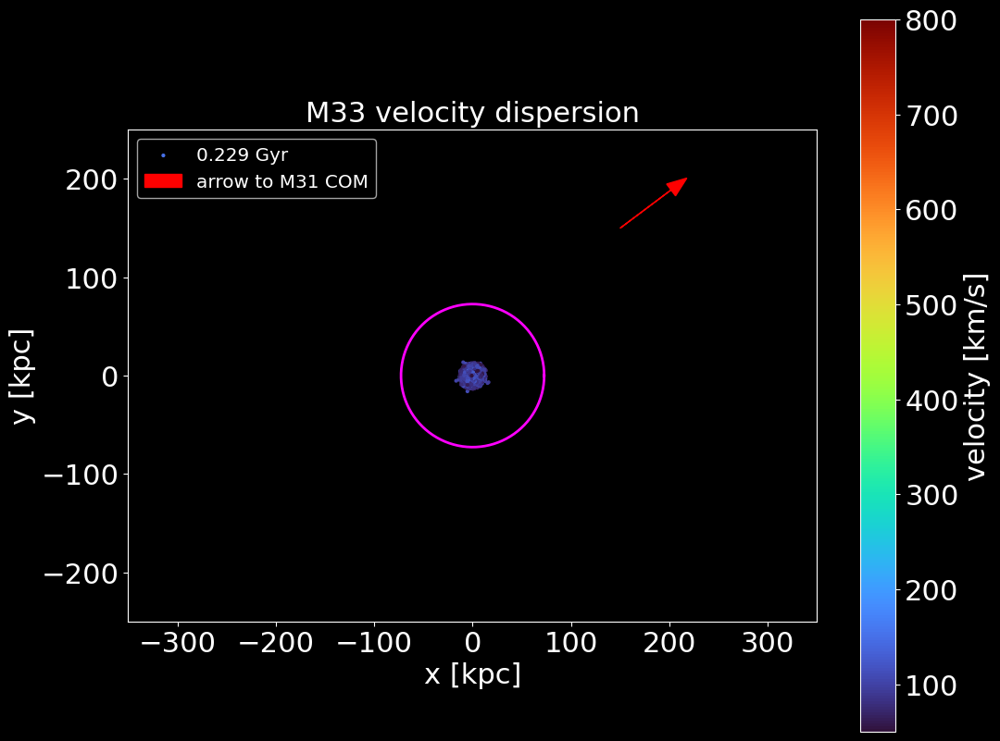

...

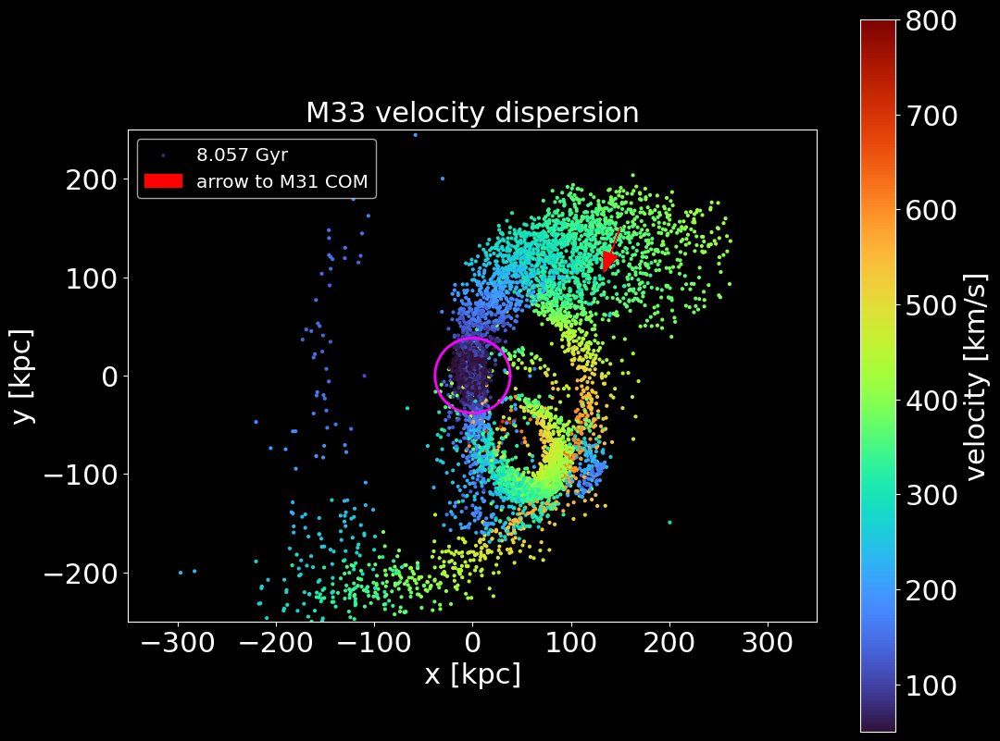

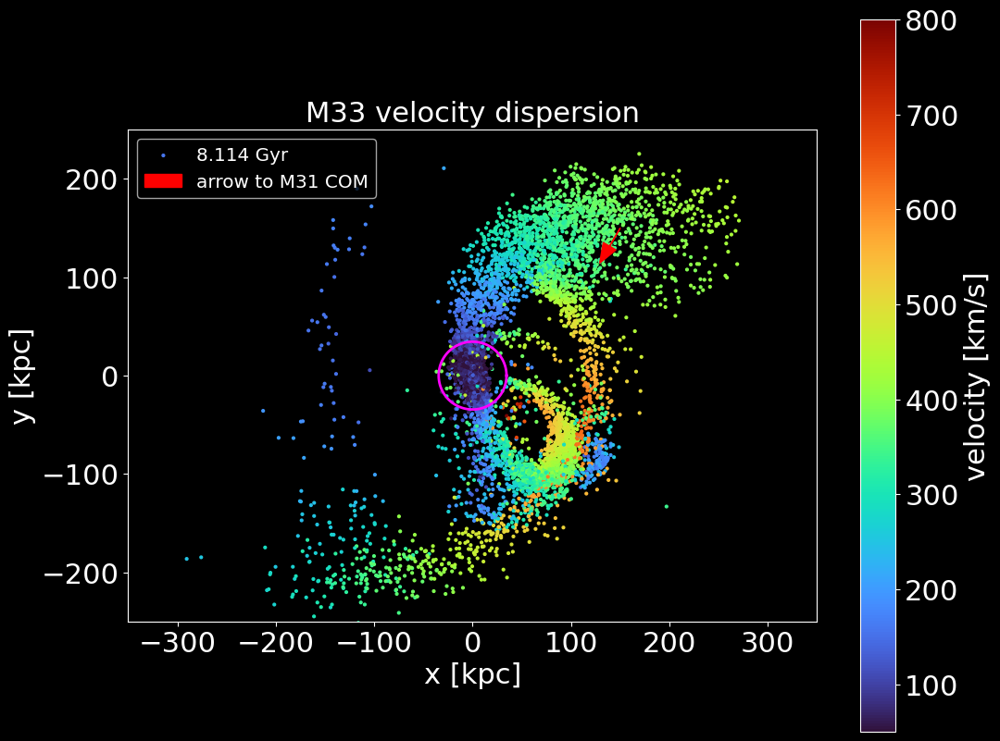

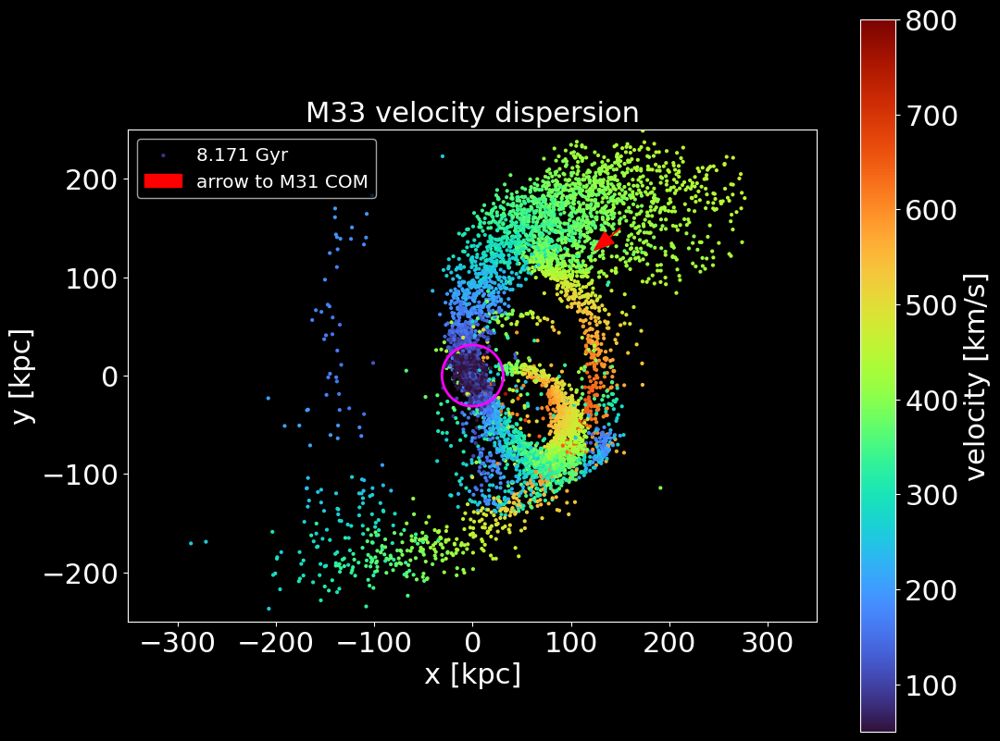

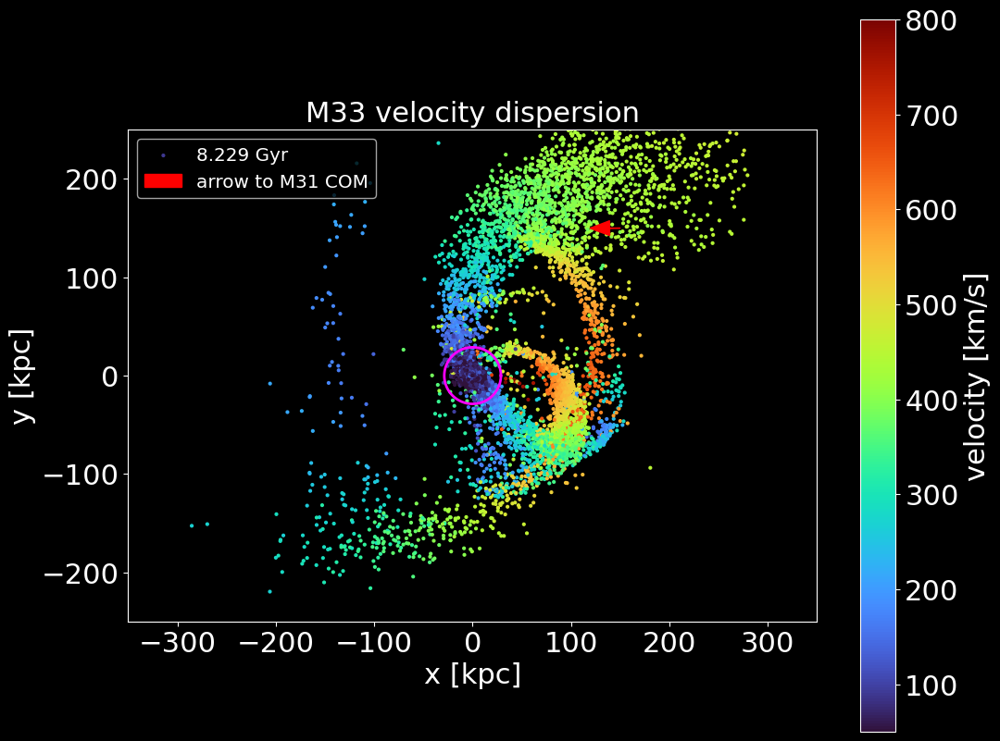

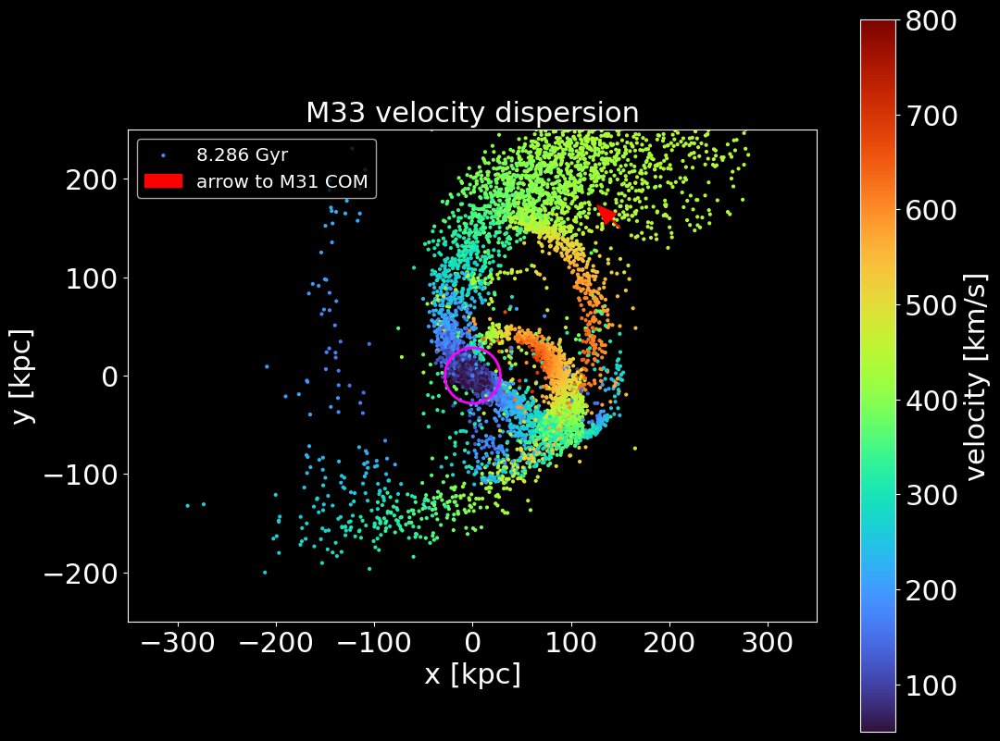

/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:66: RuntimeWarning: invalid value encountered in scalar divide
  a_com = np.sum(a*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:68: RuntimeWarning: invalid value encountered in scalar divide
  b_com = np.sum(b*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:70: RuntimeWarning: invalid value encountered in scalar divide
  c_com = np.sum(c*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:66: RuntimeWarning: invalid value encountered in scalar divide
  a_com = np.sum(a*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:68: RuntimeWarning: invalid value encountered in scalar divide
  b_com = np.sum(b*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:70: RuntimeWarning: invalid value encountered in scalar divide
  c_com = np.sum(c*m)/np.sum(m)
/opt/anaconda3/lib/pyt

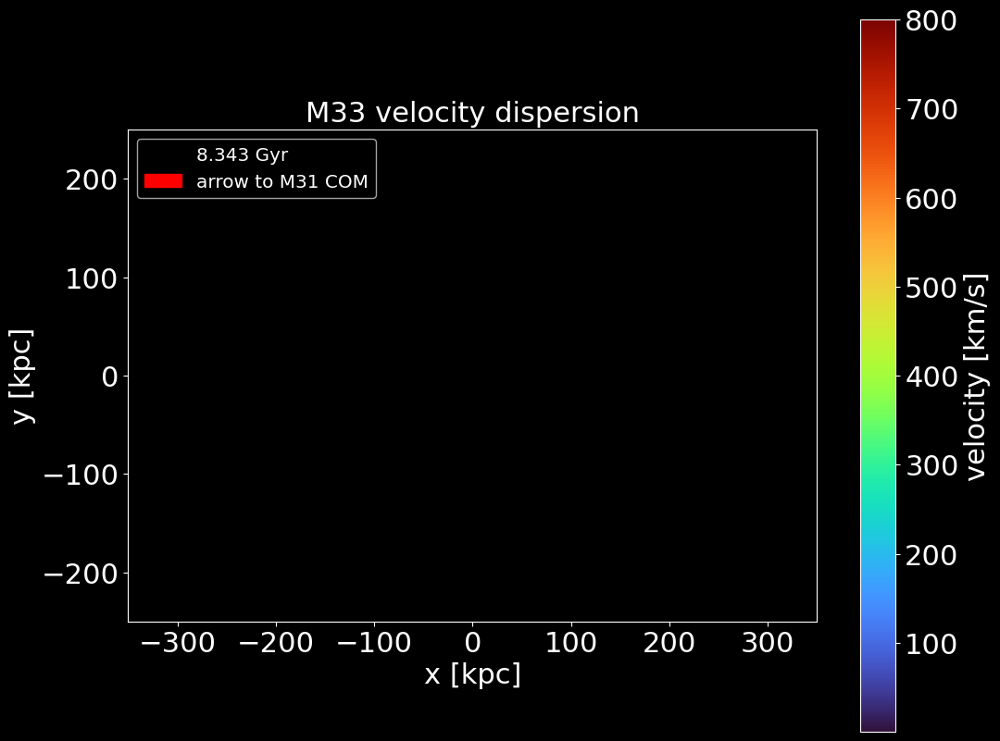

/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:66: RuntimeWarning: invalid value encountered in scalar divide
  a_com = np.sum(a*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:68: RuntimeWarning: invalid value encountered in scalar divide
  b_com = np.sum(b*m)/np.sum(m)
/Users/alondracardona/astr400b/ResearchAssignments/CenterOfMass2.py:70: RuntimeWarning: invalid value encountered in scalar divide
  c_com = np.sum(c*m)/np.sum(m)
/opt/anaconda3/lib/python3.12/site-packages/astropy/units/quantity.py:671: RuntimeWarning: divide by zero encountered in divide
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


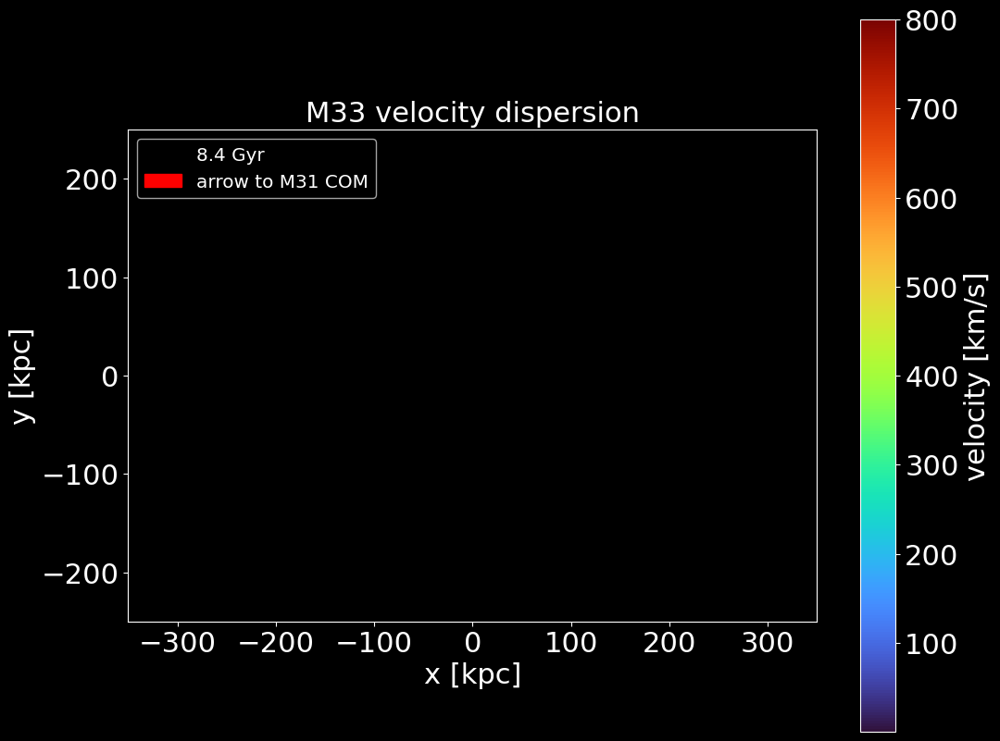

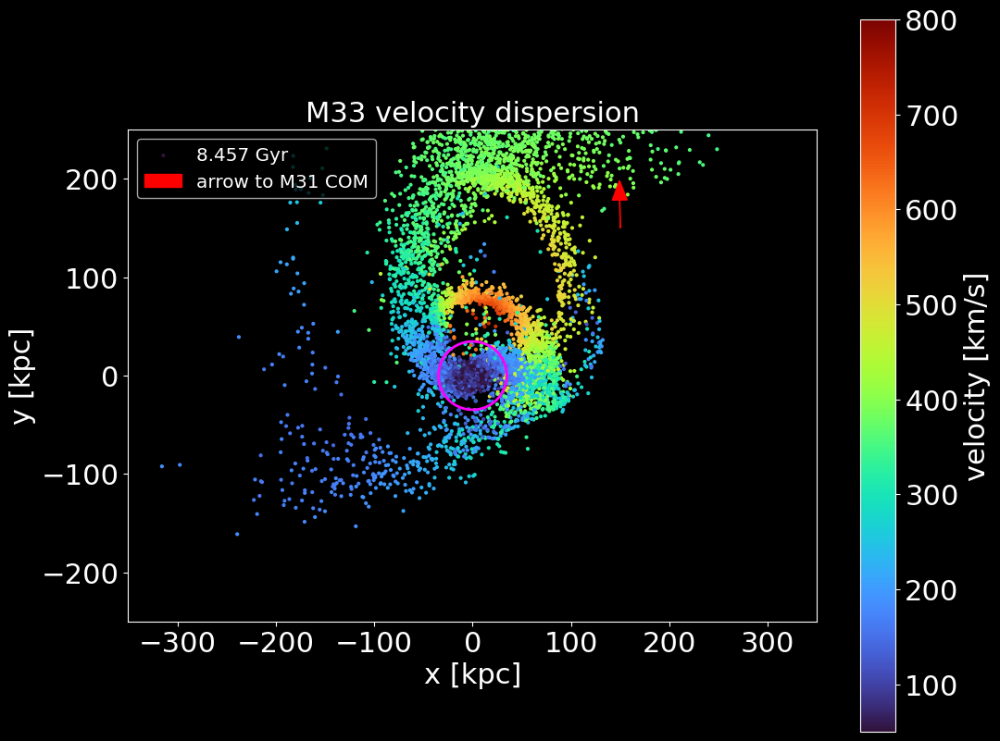

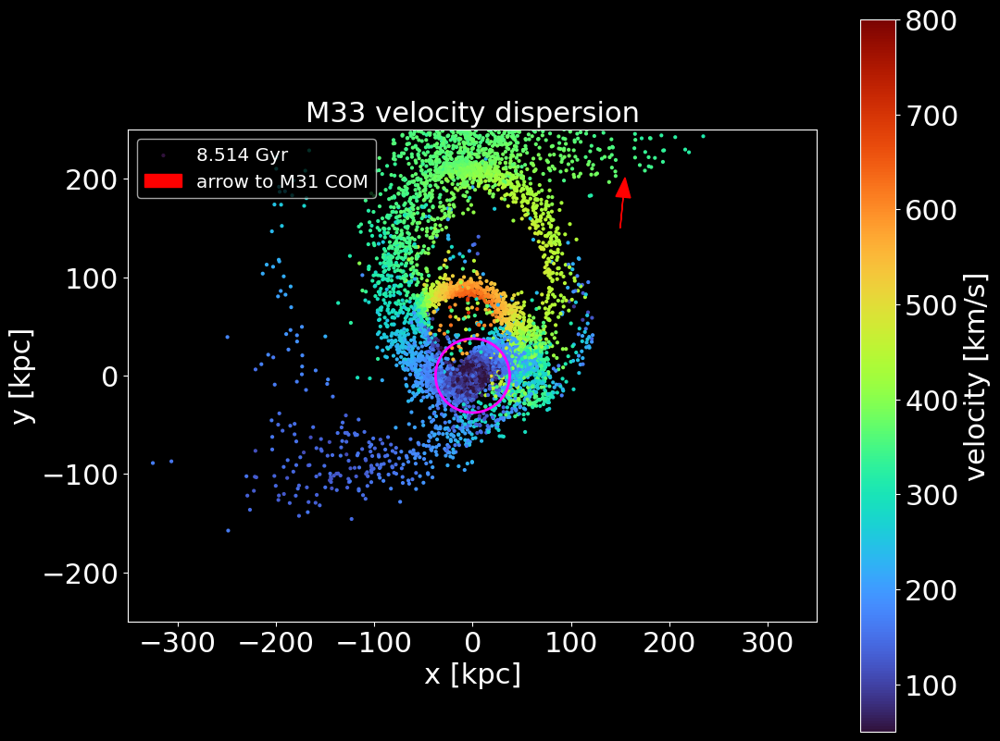

In [52]:
# create loop that iterates over tsteps and computes positions and velocities
# of disk particles at each relevant timestep

for i, step in enumerate(tsteps):# loop over numers in timestep array
    
    # create filename based on corresponding timestep
    if step < 10:
        ilbl = 'M33'+'_00'+str(step)+'.txt'
        ilbl31 = 'M31'+'_00'+str(step)+'.txt'
    elif step >= 10 and step < 100:
        ilbl = 'M33'+'_0'+str(step)+'.txt'
        ilbl31 = 'M31'+'_0'+str(step)+'.txt'
    else:
        ilbl = 'M33'+'_'+str(step)+'.txt'
        ilbl31 = 'M31'+'_'+str(step)+'.txt'

    filename = 'M33'+'/'+ilbl
    M31file = 'M31'+'/'+ilbl31

    # call Positions2D function for positions, velocities, and time
    rn, vn, dist, vel, t = Positions2D(filename)

    # Start plotting  code:
    fig, ax= plt.subplots(figsize=(12, 10))
    plt.style.use("dark_background")

    # plot disk particles
    plt.scatter(rn[:,0], rn[:,1], c=vel, cmap='turbo', s=4, label=f"{np.round(t,3)} Gyr")
    # c=vel colors the particles based on their velocity magnitude

    # plot arrow towards M31 COM
    COMM33 = CenterOfMass(filename,2)
    COMP_33 = COMM33.COM_P(0.1,4).value
    COMM31 = CenterOfMass(M31file,2)
    COMP_31 = COMM31.COM_P(0.1,2).value

    # plot arrow pointing towards M31 center of mass
    plt.arrow(0+150, 0+150, (COMP_31[0]-COMP_33[0])/2, (COMP_31[1]-COMP_33[1])/2, head_width=15, head_length=20, fc='red', ec='red', label='arrow to M31 COM')

    # plot colorbar 
    cbar = plt.colorbar()
    plt.clim(50, 800)
    cbar.set_label("velocity [km/s]", fontsize=22)
    
    #Add axis labels
    plt.xlabel('x [kpc]', fontsize=22)
    plt.ylabel('y [kpc]', fontsize=22)
    
    # add legend and title 
    plt.legend(loc='upper left',fontsize='x-large')
    plt.title('M33 velocity dispersion',fontsize=22)

    # calculate Jacobi radius

    # distnace between M31 and M33 centers of mass
    R = COMP_33-COMP_31
    R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2) # magnitude of this distance

    # find total mass of M31 within the distance between M31 and M33 centers of mass
    M31p = MassProfile(M31file,step)
    m31 = M31p.MassEnclosedTotal(np.array(R_mag))
    # find disk mass of M31 and M33
    m33 = Totmass(filename)

    # call JacobiR function to find the Jacobi Radius of M33 orbiting around
    # M33 at a distance of R_mag
    rj = JacobiR(m31, m33, R_mag)

    # plot circle of radius = jacobi radius
    theta = np.linspace(0, 2*np.pi, 100)
    circx = rj * np.cos(theta)
    circy = rj * np.sin(theta)     
    plt.plot(circx, circy, linewidth=2, color='magenta')
    plt.gca().set_aspect('equal', adjustable='box') # Ensure circle appears as a circle

    # set axis limits for all frames
    plt.ylim(-250,250)
    plt.xlim(-350,350)
    
    # adjust tick label font size
    label_size = 22
    matplotlib.rcParams['xtick.labelsize'] = label_size 
    matplotlib.rcParams['ytick.labelsize'] = label_size

    # Save file
    if i < 10:
        plt.savefig('00'+str(i)+'.png')
    elif 10 <= i < 100:
        plt.savefig('0'+str(i)+'.png')
    else:
        plt.savefig(str(i)+'.png')
    plt.show()



# Step 3: Plot significant frames of M33 velocity dispersion
Plots used to make panel of M33 stream development

In [56]:
# find positions and velocities of M33's disk particles at specific timestamps
rn1, vn1, dist1, vel1, t1 = Positions2D('M33/M33_000.txt') # present
rn2, vn2, dist2, vel2, t2 = Positions2D('M33/M33_306.txt') # first MW-M31 close encounter
rn3, vn3, dist3, vel3, t3 = Positions2D('M33/M33_330.txt') # between encounters
rn4, vn4, dist4, vel4, t4 = Positions2D('M33/M33_414.txt') # second MW-M31 close encounter
rn5, vn5, dist5, vel5, t5 = Positions2D('M33/M33_456.txt') # merger
rn6, vn6, dist6, vel6, t6 = Positions2D('M33/M33_562.txt') # remant

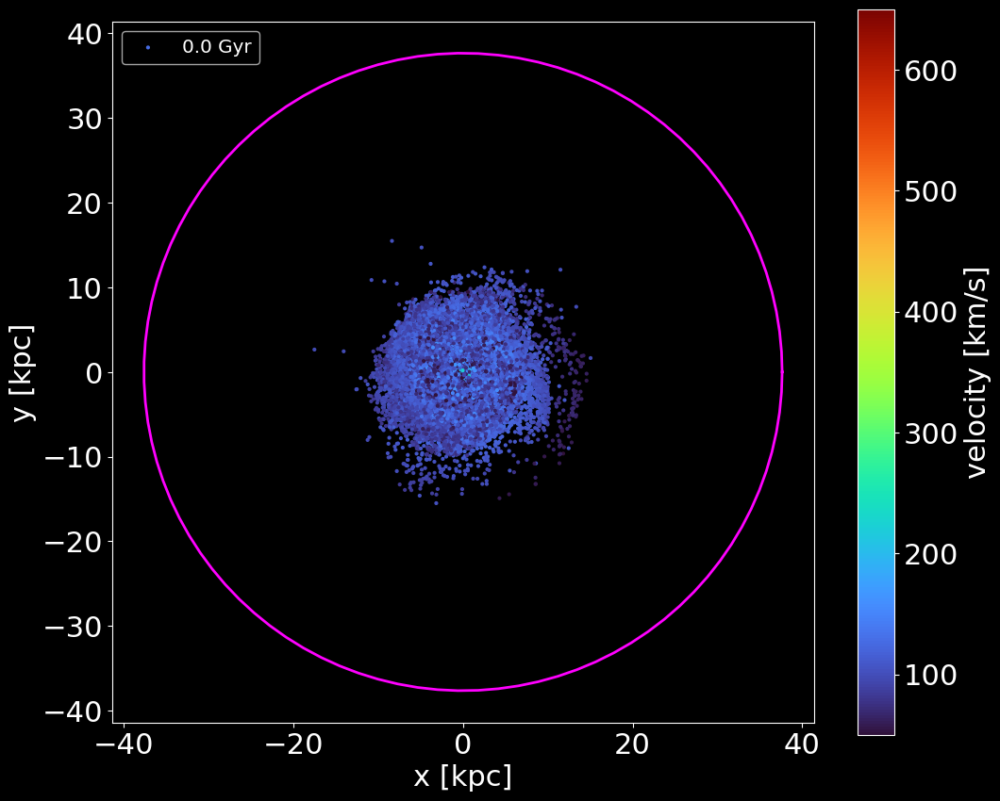

In [58]:

fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn1[:,0], rn1[:,1], c=vel1, cmap='turbo', s=4, label=f"{np.round(t1,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 

# calculate Jacobi radius

# distnace between M31 and M33 centers of mass
R = COMP_33-COMP_31
R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2) # magnitude of this distance

# find total mass of M31 within the distance between M31 and M33 centers of mass
M31p = MassProfile(M31file,step)
m31 = M31p.MassEnclosedTotal(np.array(R_mag))
# find disk mass of M31 and M33
m33 = Totmass(filename)

# call JacobiR function to find the Jacobi Radius of M33 orbiting around
# M33 at a distance of R_mag
rj = JacobiR(m31, m33, R_mag)

# plot circle of radius = jacobi radius
theta = np.linspace(0, 2*np.pi, 100)
circx = rj * np.cos(theta)
circy = rj * np.sin(theta)     
plt.plot(circx, circy, linewidth=2, color='magenta')
plt.gca().set_aspect('equal', adjustable='box') # Ensure circle appears as a circle

#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_0.png')


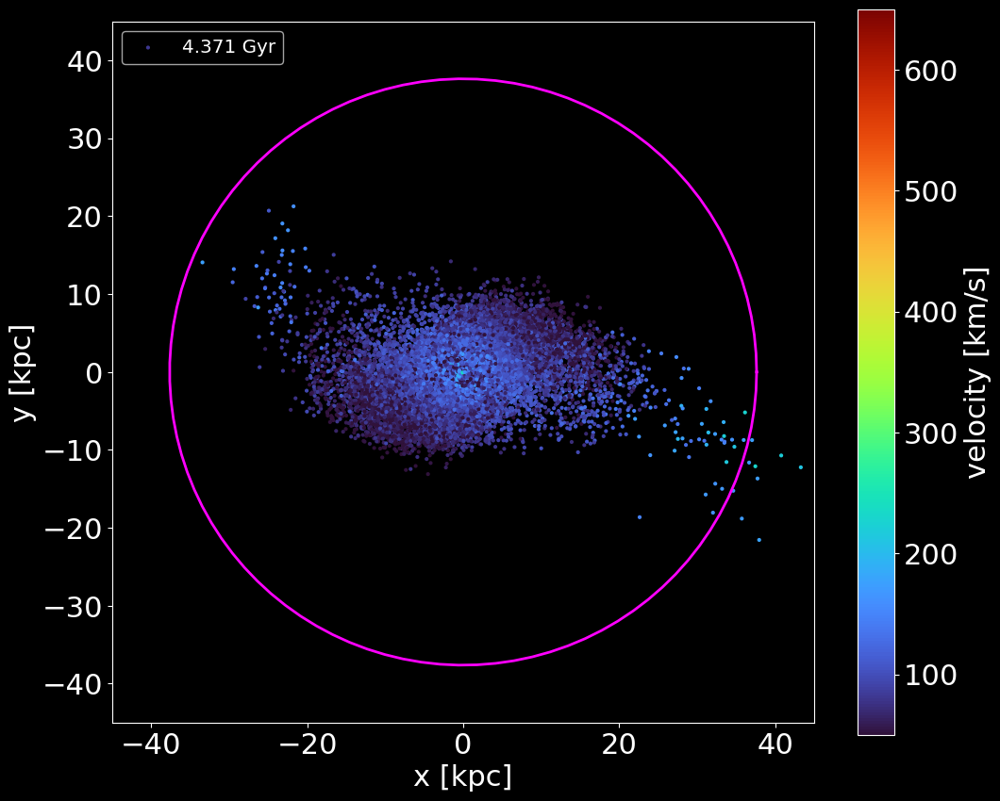

In [96]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn2[:,0], rn2[:,1], c=vel2, cmap='turbo', s=4, label=f"{np.round(t2,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 

# calculate Jacobi radius

# distnace between M31 and M33 centers of mass
R = COMP_33-COMP_31
R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2) # magnitude of this distance

# find total mass of M31 within the distance between M31 and M33 centers of mass
M31p = MassProfile(M31file,step)
m31 = M31p.MassEnclosedTotal(np.array(R_mag))
# find disk mass of M31 and M33
m33 = Totmass(filename)

# call JacobiR function to find the Jacobi Radius of M33 orbiting around
# M33 at a distance of R_mag
rj = JacobiR(m31, m33, R_mag)

# plot circle of radius = jacobi radius
theta = np.linspace(0, 2*np.pi, 100)
circx = rj * np.cos(theta)
circy = rj * np.sin(theta)     
plt.plot(circx, circy, linewidth=2, color='magenta')
plt.gca().set_aspect('equal', adjustable='box') # Ensure circle appears as a circle

plt.ylim(-45,45)
plt.xlim(-45,45)

#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_1.png')

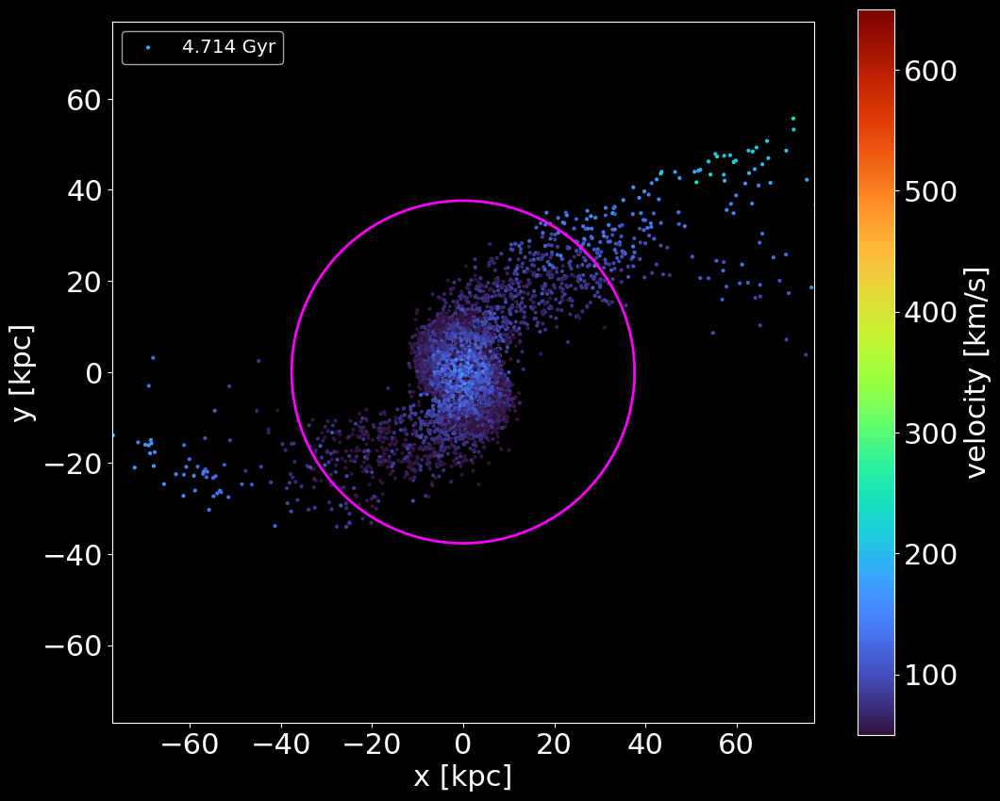

In [98]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn3[:,0], rn3[:,1], c=vel3, cmap='turbo', s=4, label=f"{np.round(t3,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 

# calculate Jacobi radius

# distnace between M31 and M33 centers of mass
R = COMP_33-COMP_31
R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2) # magnitude of this distance

# find total mass of M31 within the distance between M31 and M33 centers of mass
M31p = MassProfile(M31file,step)
m31 = M31p.MassEnclosedTotal(np.array(R_mag))
# find disk mass of M31 and M33
m33 = Totmass(filename)

# call JacobiR function to find the Jacobi Radius of M33 orbiting around
# M33 at a distance of R_mag
rj = JacobiR(m31, m33, R_mag)

# plot circle of radius = jacobi radius
theta = np.linspace(0, 2*np.pi, 100)
circx = rj * np.cos(theta)
circy = rj * np.sin(theta)     
plt.plot(circx, circy, linewidth=2, color='magenta')
plt.gca().set_aspect('equal', adjustable='box') # Ensure circle appears as a circle


# set axis limits for all frames
plt.ylim(-77,77)
plt.xlim(-77,77)

#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_2.png')

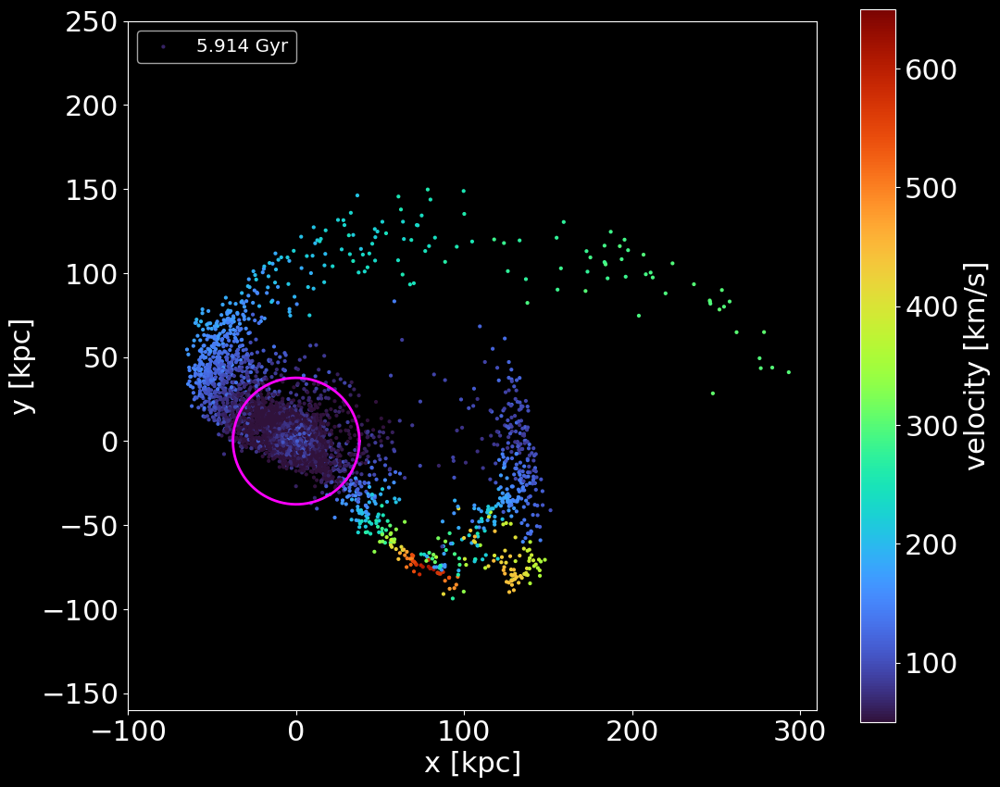

In [114]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn4[:,0], rn4[:,1], c=vel4, cmap='turbo', s=4, label=f"{np.round(t4,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 

# calculate Jacobi radius

# distnace between M31 and M33 centers of mass
R = COMP_33-COMP_31
R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2) # magnitude of this distance

# find total mass of M31 within the distance between M31 and M33 centers of mass
M31p = MassProfile(M31file,step)
m31 = M31p.MassEnclosedTotal(np.array(R_mag))
# find disk mass of M31 and M33
m33 = Totmass(filename)

# call JacobiR function to find the Jacobi Radius of M33 orbiting around
# M33 at a distance of R_mag
rj = JacobiR(m31, m33, R_mag)

# plot circle of radius = jacobi radius
theta = np.linspace(0, 2*np.pi, 100)
circx = rj * np.cos(theta)
circy = rj * np.sin(theta)     
plt.plot(circx, circy, linewidth=2, color='magenta')
plt.gca().set_aspect('equal', adjustable='box') # Ensure circle appears as a circle

# set axis limits for all frames
plt.ylim(-160,250)
plt.xlim(-100,310)

#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_3.png')

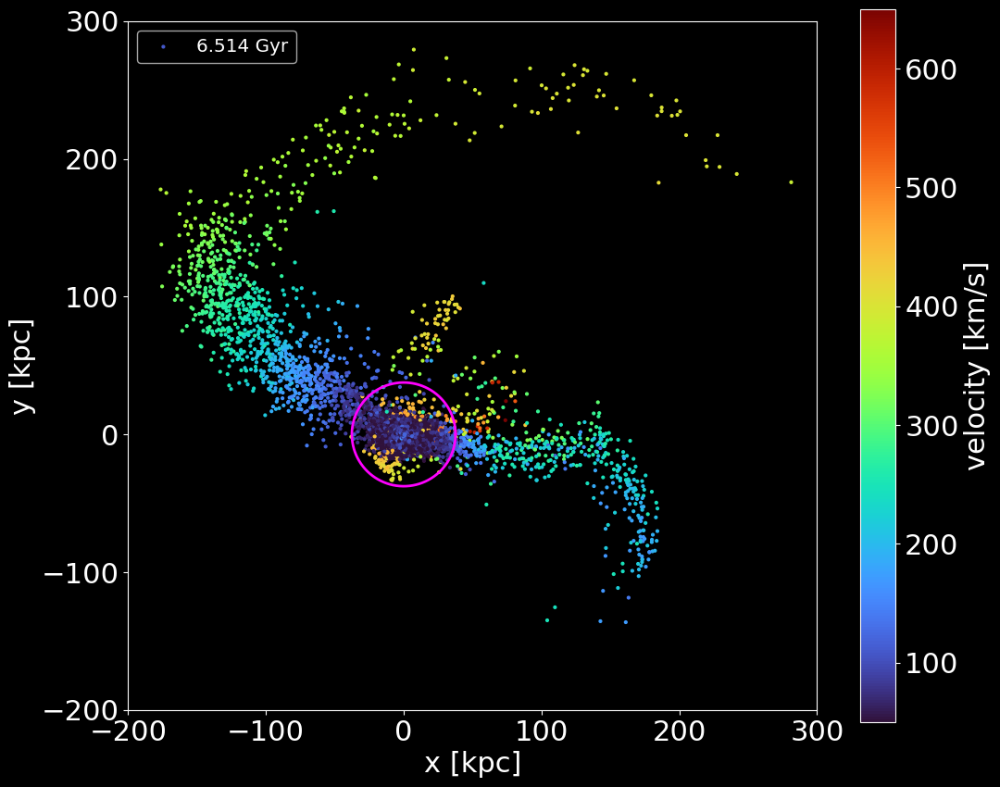

In [110]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn5[:,0], rn5[:,1], c=vel5, cmap='turbo', s=4, label=f"{np.round(t5,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 

# calculate Jacobi radius

# distnace between M31 and M33 centers of mass
R = COMP_33-COMP_31
R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2) # magnitude of this distance

# find total mass of M31 within the distance between M31 and M33 centers of mass
M31p = MassProfile(M31file,step)
m31 = M31p.MassEnclosedTotal(np.array(R_mag))
# find disk mass of M31 and M33
m33 = Totmass(filename)

# call JacobiR function to find the Jacobi Radius of M33 orbiting around
# M33 at a distance of R_mag
rj = JacobiR(m31, m33, R_mag)

# plot circle of radius = jacobi radius
theta = np.linspace(0, 2*np.pi, 100)
circx = rj * np.cos(theta)
circy = rj * np.sin(theta)     
plt.plot(circx, circy, linewidth=2, color='magenta')
plt.gca().set_aspect('equal', adjustable='box') # Ensure circle appears as a circle

# set axis limits
plt.ylim(-200,300)
plt.xlim(-200,300)

#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_4.png')

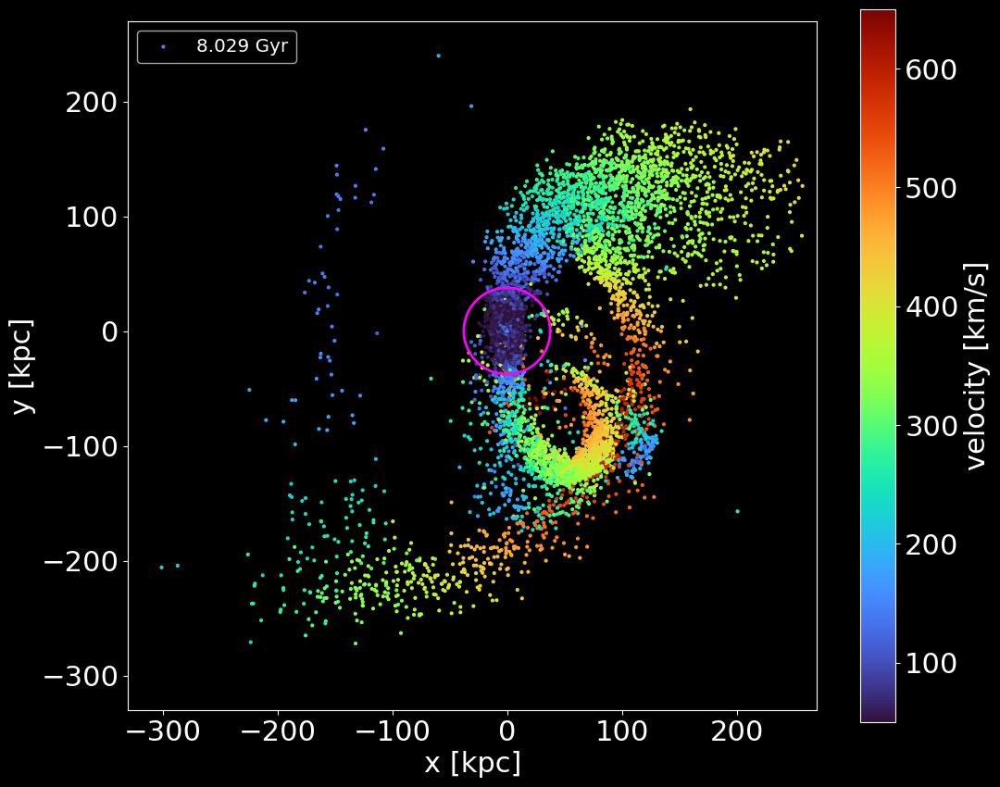

In [116]:
fig, ax= plt.subplots(figsize=(12, 10))
plt.style.use("dark_background")

plt.scatter(rn6[:,0], rn6[:,1], c=vel6, cmap='turbo', s=4, label=f"{np.round(t6,3)} Gyr")

cbar = plt.colorbar()
plt.clim(50, 650)
cbar.set_label("velocity [km/s]", fontsize=22)
cbar.ax.tick_params(labelsize=22) 

# calculate Jacobi radius

# distnace between M31 and M33 centers of mass
R = COMP_33-COMP_31
R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2) # magnitude of this distance

# find total mass of M31 within the distance between M31 and M33 centers of mass
M31p = MassProfile(M31file,step)
m31 = M31p.MassEnclosedTotal(np.array(R_mag))
# find disk mass of M33
m33 = Totmass(filename)

# call JacobiR function to find the Jacobi Radius of M33 orbiting around
# M33 at a distance of R_mag
rj = JacobiR(m31, m33, R_mag)

# plot circle of radius = jacobi radius
theta = np.linspace(0, 2*np.pi, 100)
circx = rj * np.cos(theta)
circy = rj * np.sin(theta)     
plt.plot(circx, circy, linewidth=2, color='magenta')
plt.gca().set_aspect('equal', adjustable='box') # Ensure circle appears as a circle

# set axis limits
plt.ylim(-330,270)
plt.xlim(-330,270)

#Add axis labels
plt.xlabel('x [kpc]', fontsize=22)
plt.ylabel('y [kpc]', fontsize=22)

plt.legend(loc='upper left',fontsize='x-large')
#plt.title('M33 velocity dispersion',fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('M33_5.png')

# Step 4: Select for stellar stream particles using M33's Jacobi radius

Use lab9 tracking particles code to choose stellar stream particles, where cylindrical radius index is jacobi radius.
Make plots used for stellar stream movie.

In [ ]:
def find_nearest(array, value):
    ''' function that finds the array index that contains any given 
    valid value. Original function.
    
    PARAMETERS
    ----------
        array : `array of floats`
             array of values
        value : `float`
             value believed to be in the array
             
    RETURNS
    -------
        array[idx]: `integer`
            number index where the inputted value
            is present in the inputted array
    '''
    
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]

velocities: 133.41737409108308 133.41737409108308 133.41737409108308 133.41737409108308 133.41737409108308 133.41737409108308 133.41737409108308 133.41737409108308
positions: 28.063527219863158 28.063527219863158 28.063527219863158 28.063527219863158 28.063527219863158 28.063527219863158 28.063527219863158 28.063527219863158


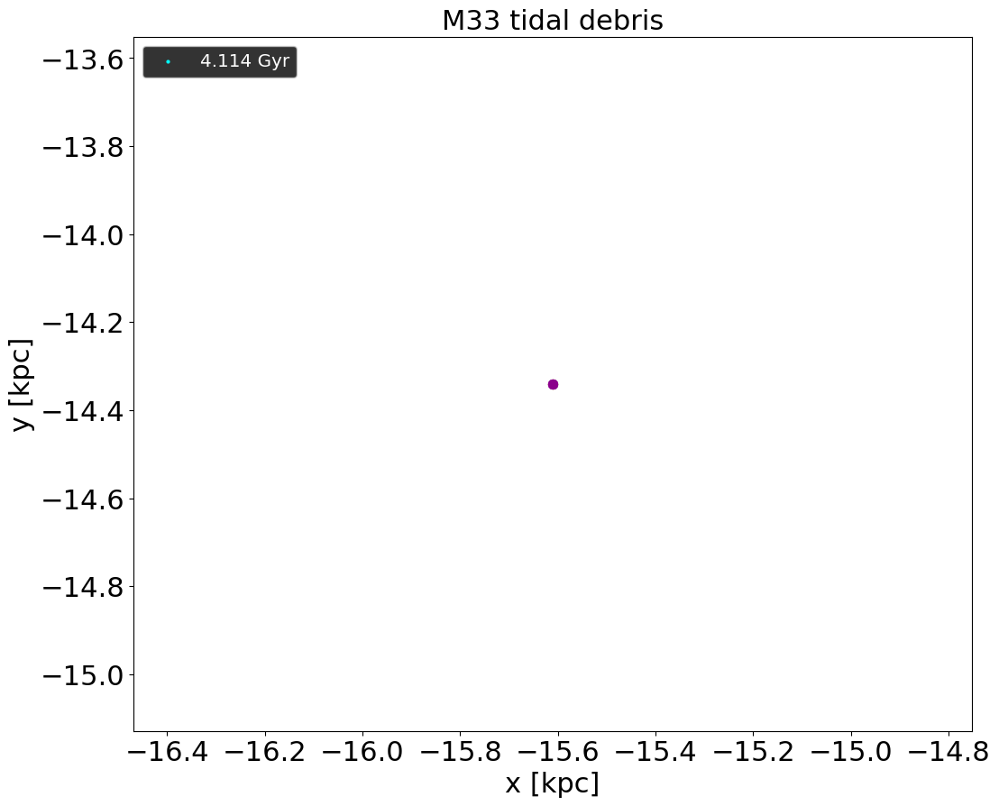

velocities: 180.54127560594003 180.54127560594003 180.54127560594003 180.54127560594003 180.54127560594003 180.54127560594003 180.54127560594003 180.54127560594003
positions: 42.43266946646181 42.43266946646181 42.43266946646181 42.43266946646181 42.43266946646181 42.43266946646181 42.43266946646181 42.43266946646181


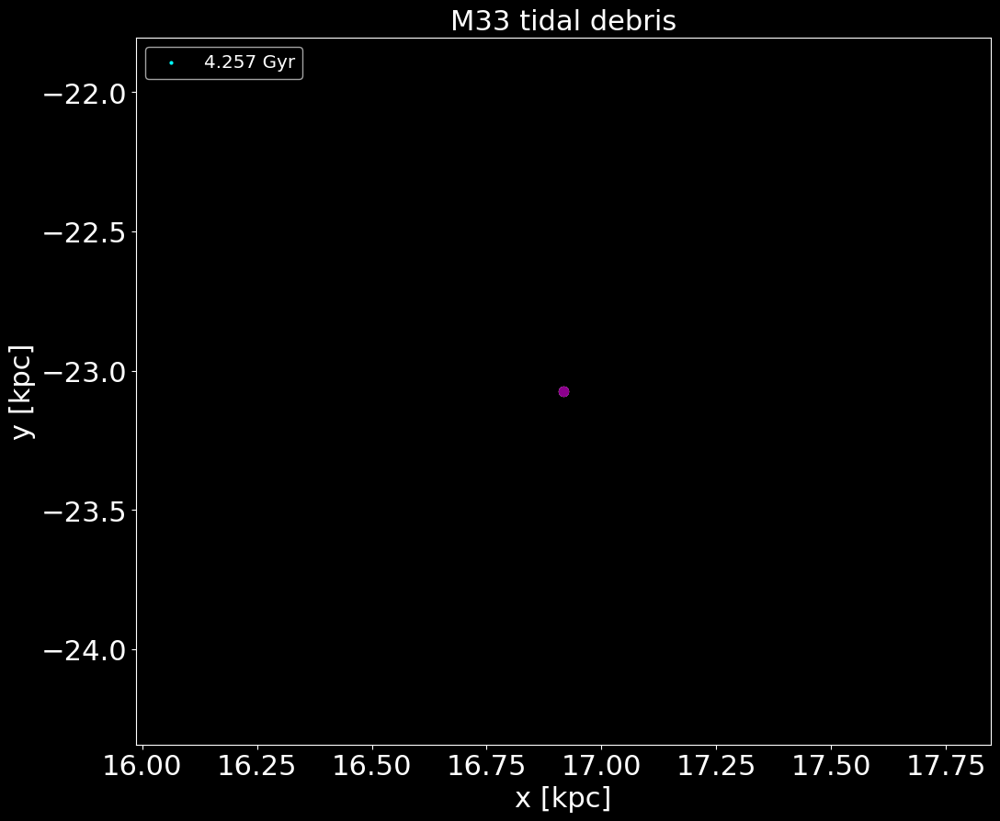

velocities: 181.29190892855644 208.4302810427506 173.09492209259056 173.09492209259056 173.09492209259056 173.09492209259056 173.09492209259056 173.09492209259056
positions: 43.771466919558456 54.09601422045805 57.31625593782274 57.31625593782274 57.31625593782274 57.31625593782274 57.31625593782274 57.31625593782274


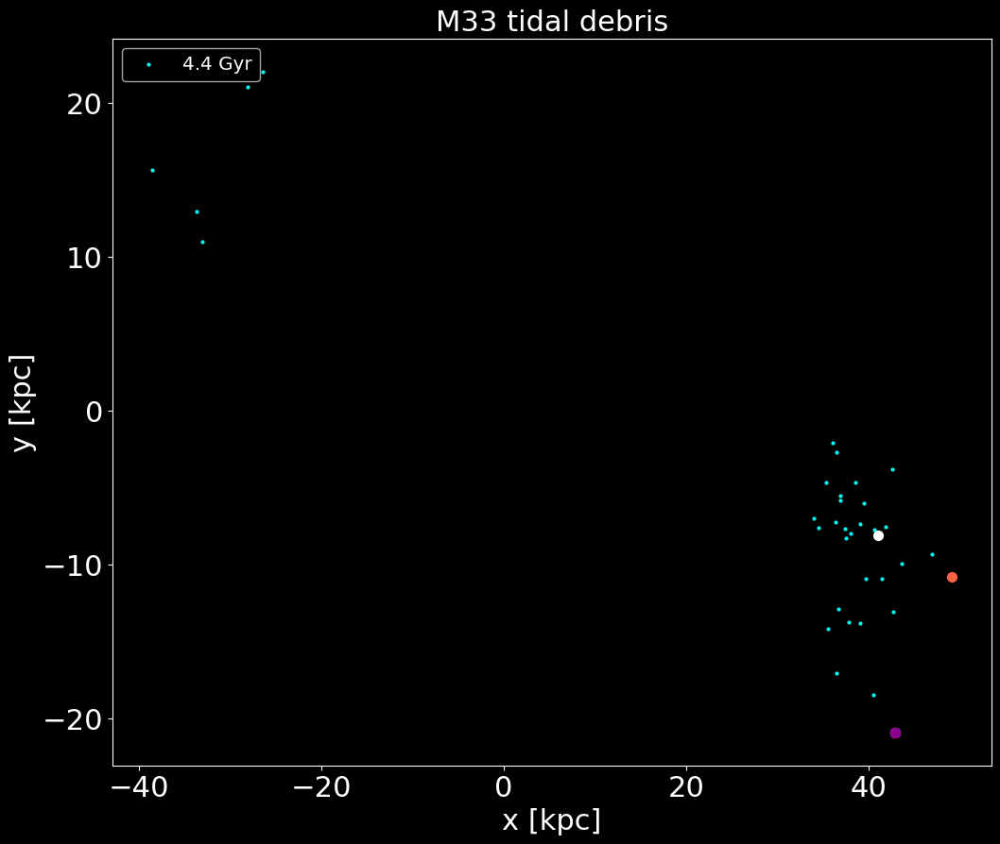

velocities: 165.4816923715116 215.9266635897849 206.47874115513685 206.47874115513685 206.47874115513685 206.47874115513685 206.47874115513685 206.47874115513685
positions: 51.10093960329888 61.10306695494097 74.56169641478124 74.56169641478124 74.56169641478124 74.56169641478124 74.56169641478124 74.56169641478124


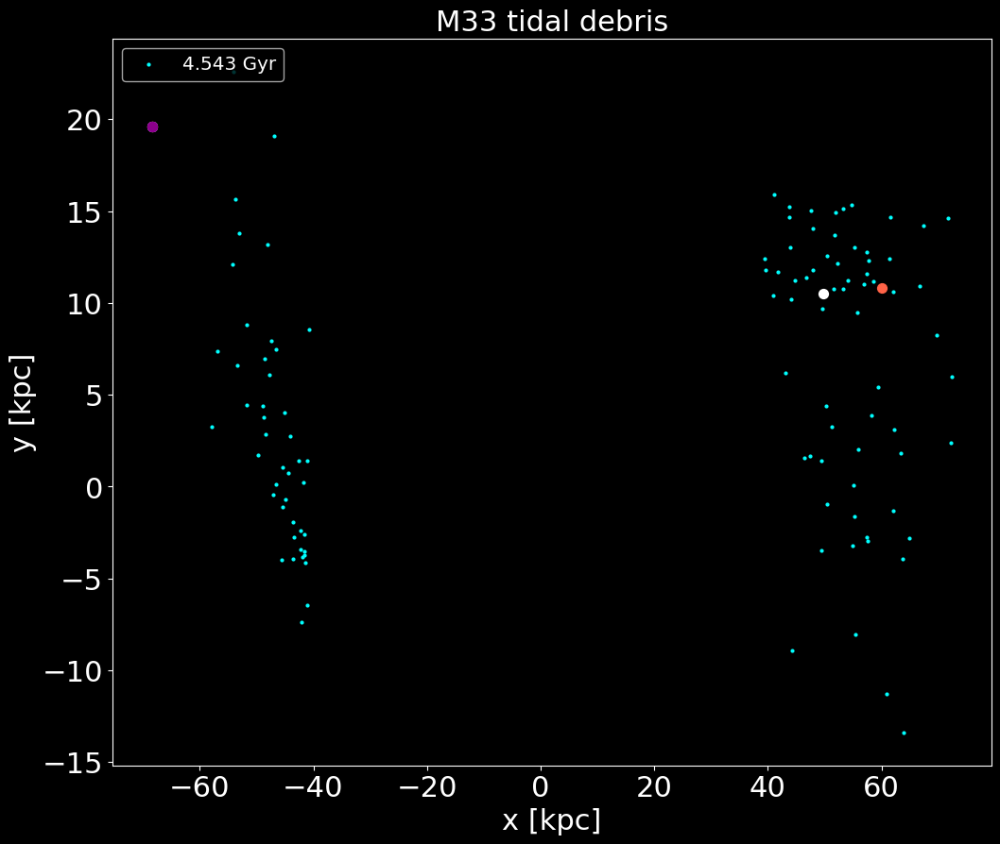

velocities: 126.86076330568093 165.3316223994067 215.121877524858 218.3863294519371 218.3863294519371 218.3863294519371 218.3863294519371 218.3863294519371
positions: 58.13576650230046 68.05082847115087 82.83460494412948 100.31241721362316 100.31241721362316 100.31241721362316 100.31241721362316 100.31241721362316


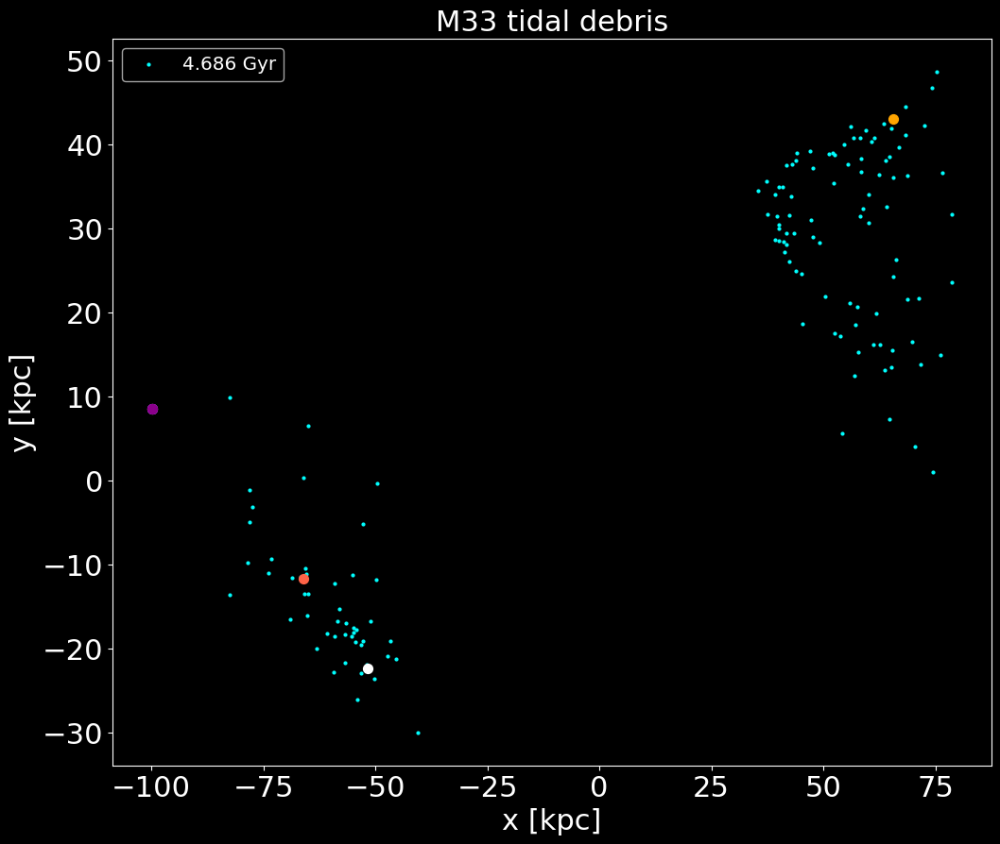

velocities: 92.46827730297564 130.30766800952276 212.06661562605746 218.97312360618594 231.36491232632926 231.36491232632926 231.36491232632926 231.36491232632926
positions: 64.3800928450713 74.4157792609202 89.60317555930929 108.61397894493142 128.43441111326044 128.43441111326044 128.43441111326044 128.43441111326044


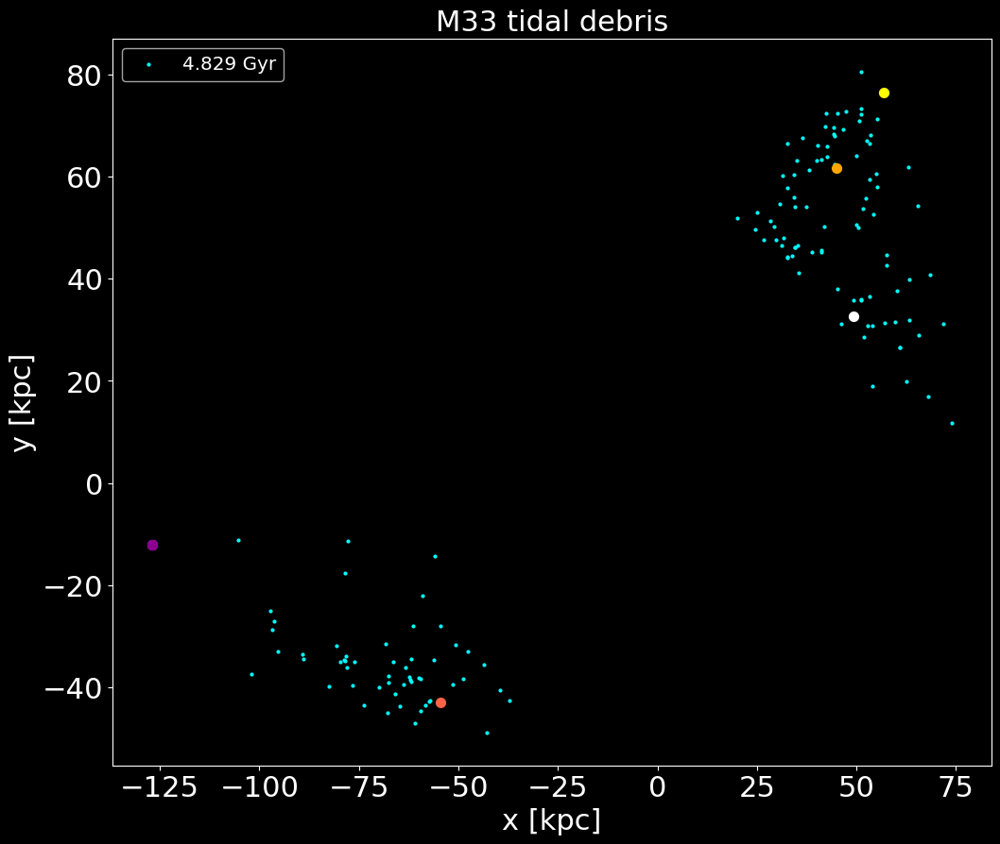

velocities: 146.33454183418212 145.9119694438054 221.13214537036447 176.0656126800461 220.11006299860531 240.14992037677214 240.14992037677214 240.14992037677214
positions: 70.57734602618606 80.17707154839596 95.4777212600177 115.3364779386383 138.56443078380542 158.2252533340048 158.2252533340048 158.2252533340048


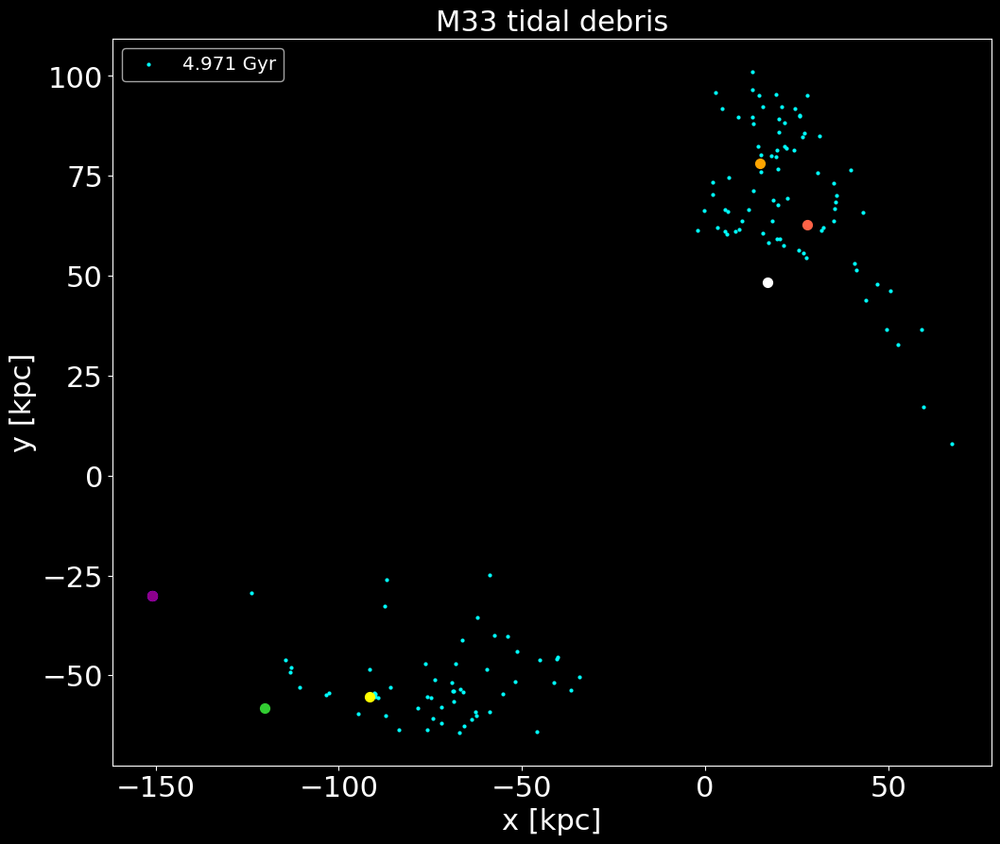

velocities: 179.9875896259517 218.0932462001976 255.556306650824 307.50106401189896 389.2964498823486 226.01526549711193 268.0562648278902 268.0562648278902
positions: 76.80466861591164 87.03479426753474 102.35546267348363 122.0746214455732 140.95204625385045 159.74381233224653 190.55643339168586 190.55643339168586


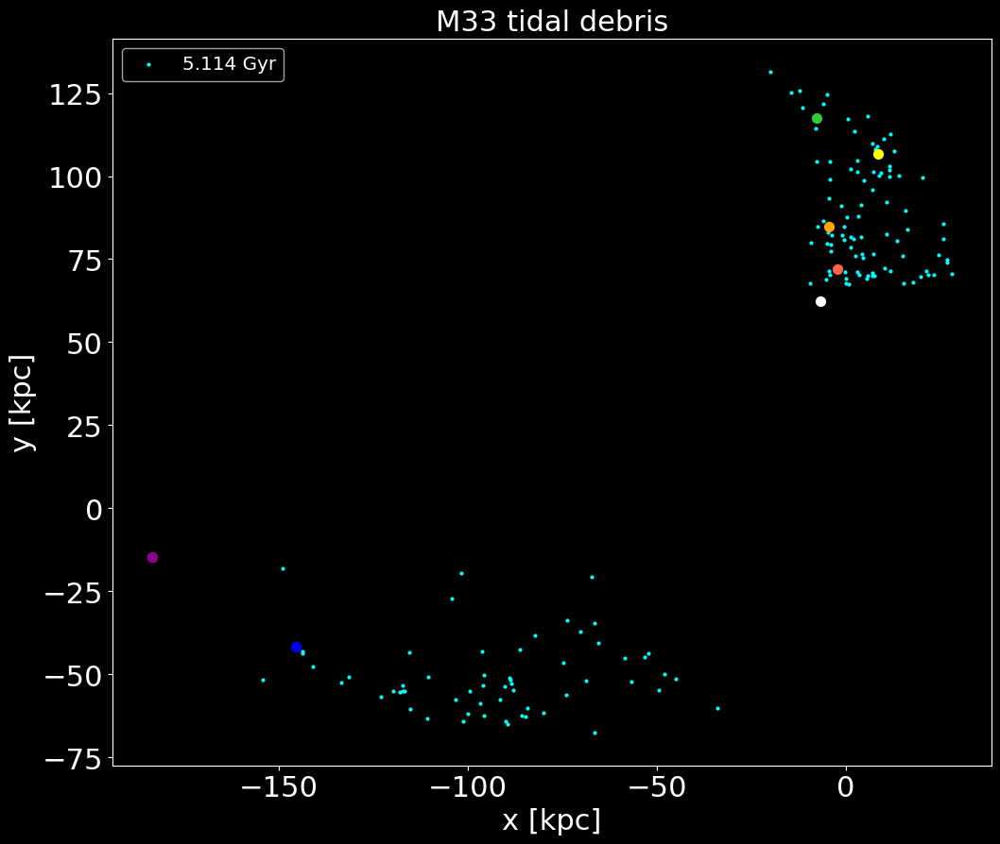

velocities: 193.06486059353213 229.8020759566806 305.60099712561475 343.06648575143566 275.30197982624463 290.94540743077556 315.35028026873545 366.5244908777175
positions: 84.26608914220773 94.48256141268398 108.85809755826206 129.07816109416652 150.0292914601679 169.40273650944957 189.78834019507102 229.7209801136152


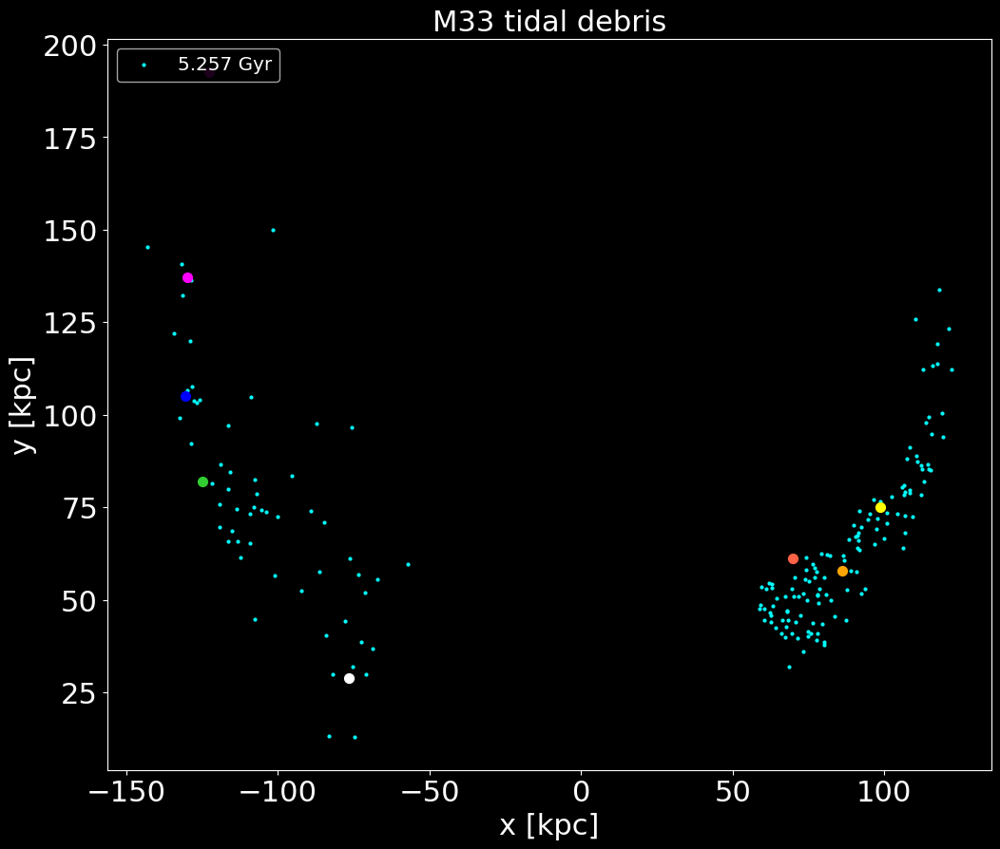

velocities: 175.07804500684375 250.60822579566297 255.33413380527483 276.6679697948608 275.02103897791164 298.45058466352515 313.3580917029111 327.5631179952347
positions: 87.85679595096784 97.6008177043743 112.22507803232575 132.94067942387971 153.00268868140716 173.07485788655987 192.81305698071904 221.52917526140885


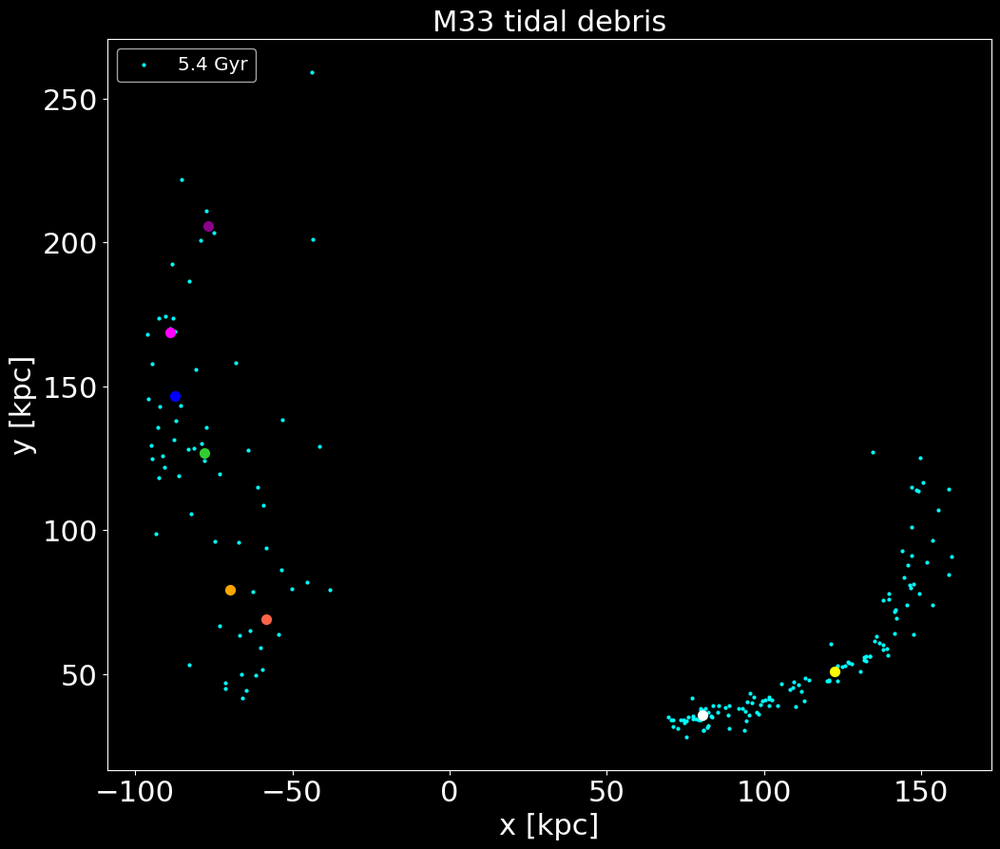

velocities: 236.5964458069328 216.4053746671928 229.33309747334772 260.4716851408199 340.0040083012846 495.2597806830371 285.73796763370456 294.9783812499486
positions: 87.37014287209334 97.55103224184768 111.99210600677576 131.16975838968065 153.0502702525056 172.25268741273675 192.6213570305027 222.2221545126633


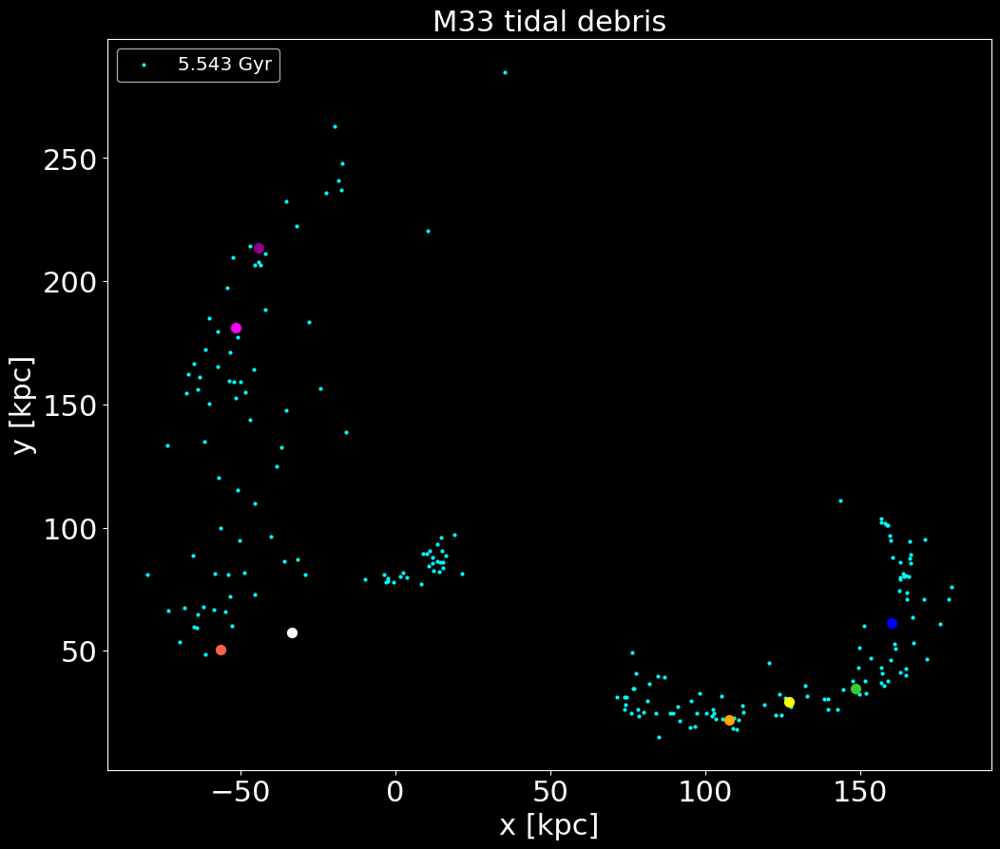

velocities: 384.50097803694854 241.742936233926 212.82759005385088 233.91062788979897 417.40348066713574 470.1896587048677 420.9240369364316 291.14610483741666
positions: 84.02854113579505 93.98541677563603 109.0442246487635 129.17980002190745 149.01020916609204 169.3727154827778 189.13135197859185 218.56028047385462


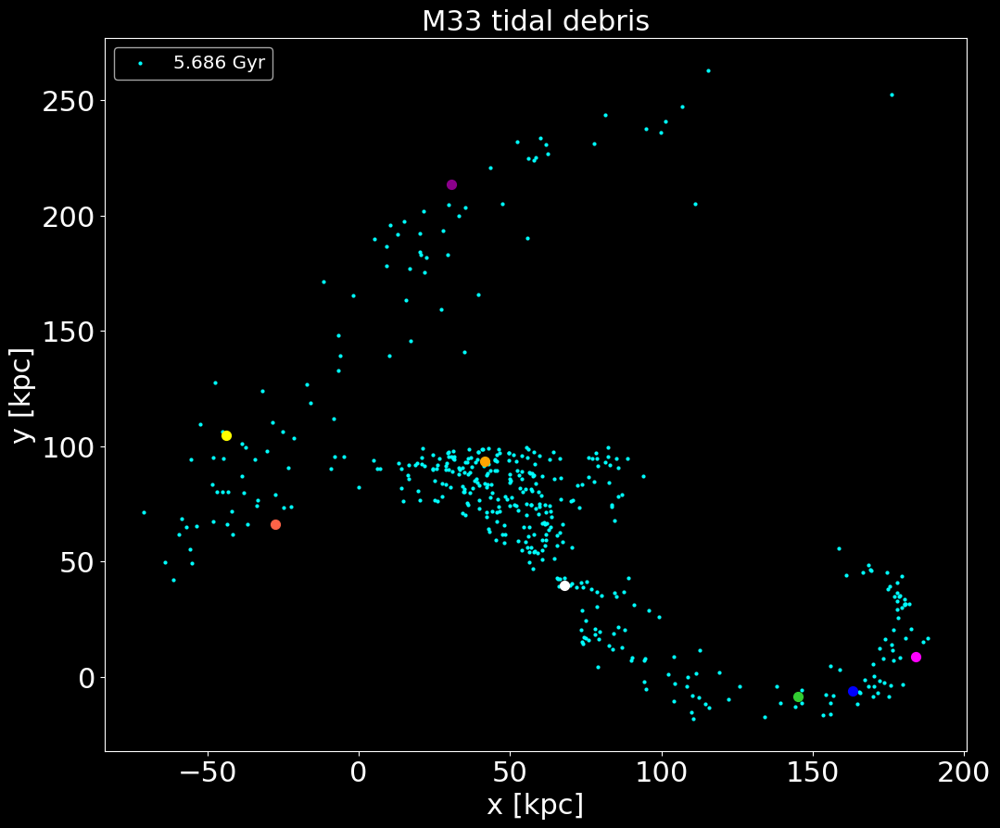

velocities: 138.588713144325 287.96976058817353 182.2638978569261 243.3259690312565 347.34248246975204 278.8434070446171 423.8175729944783 284.40704678564134
positions: 76.86353463906015 86.96445568144493 102.32854821451342 121.79377253289924 141.85532546291944 161.68600398952282 181.9220494492353 211.80902605708283


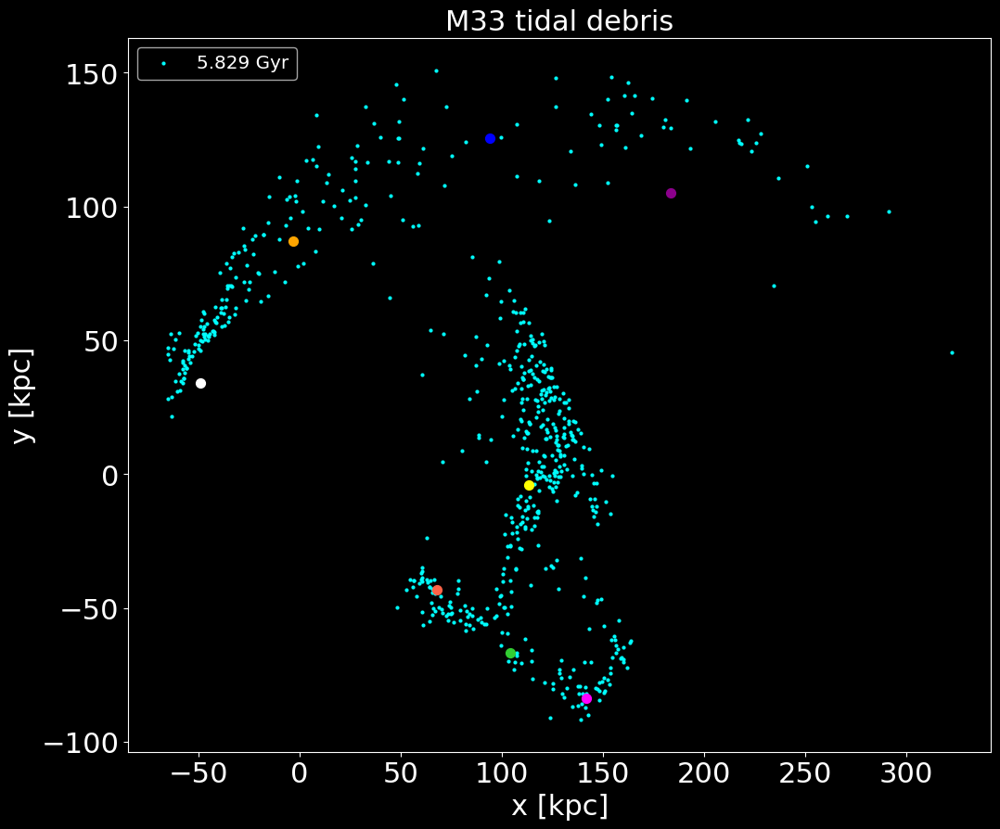

velocities: 111.5412242325231 143.4871786118885 164.19955710963413 444.72594238453195 278.7246208392793 121.27439878469363 383.4100114420592 279.50525423743005
positions: 69.00850714223573 79.04228112219434 94.10819335743302 113.96029970283556 134.08040297549263 154.0461837307241 173.8447551389745 204.0689993327747


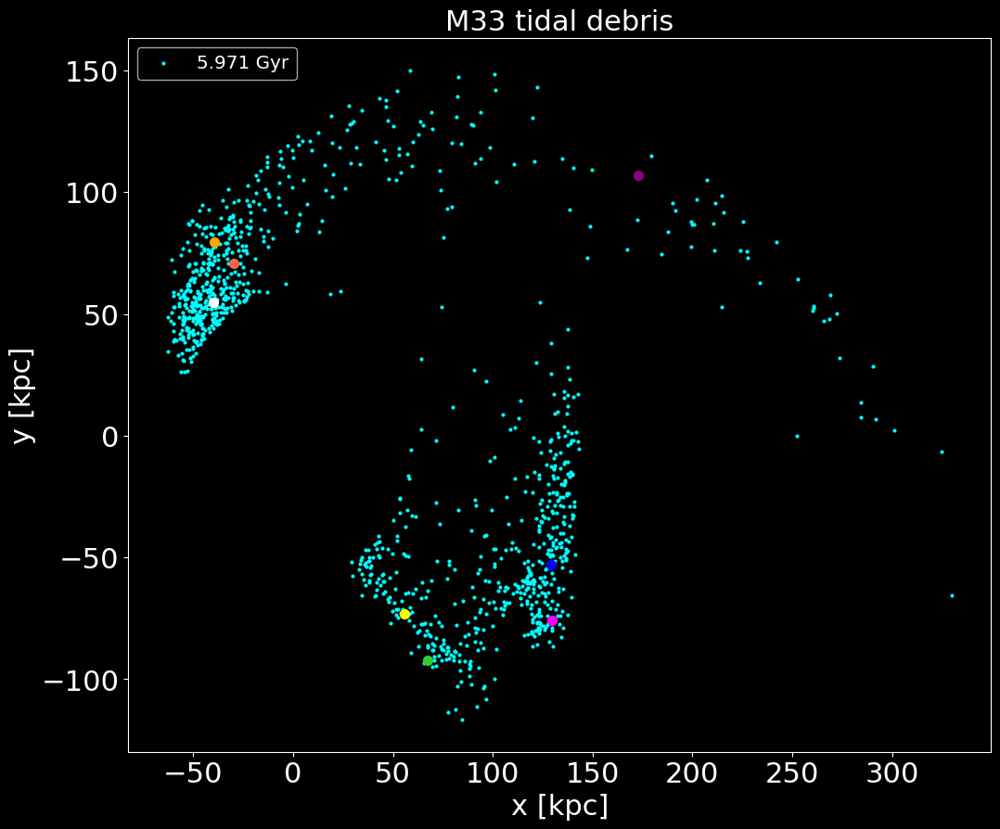

velocities: 102.59995958839362 132.617264523666 150.8323211656242 181.05653793942378 225.09021854805243 226.6913112529018 309.4869855523007 273.5071617645322
positions: 66.52995988274756 76.54751637910925 91.47327138022341 111.45990641930398 131.7451515332086 151.59110607228544 171.5073471799095 200.94733128919628


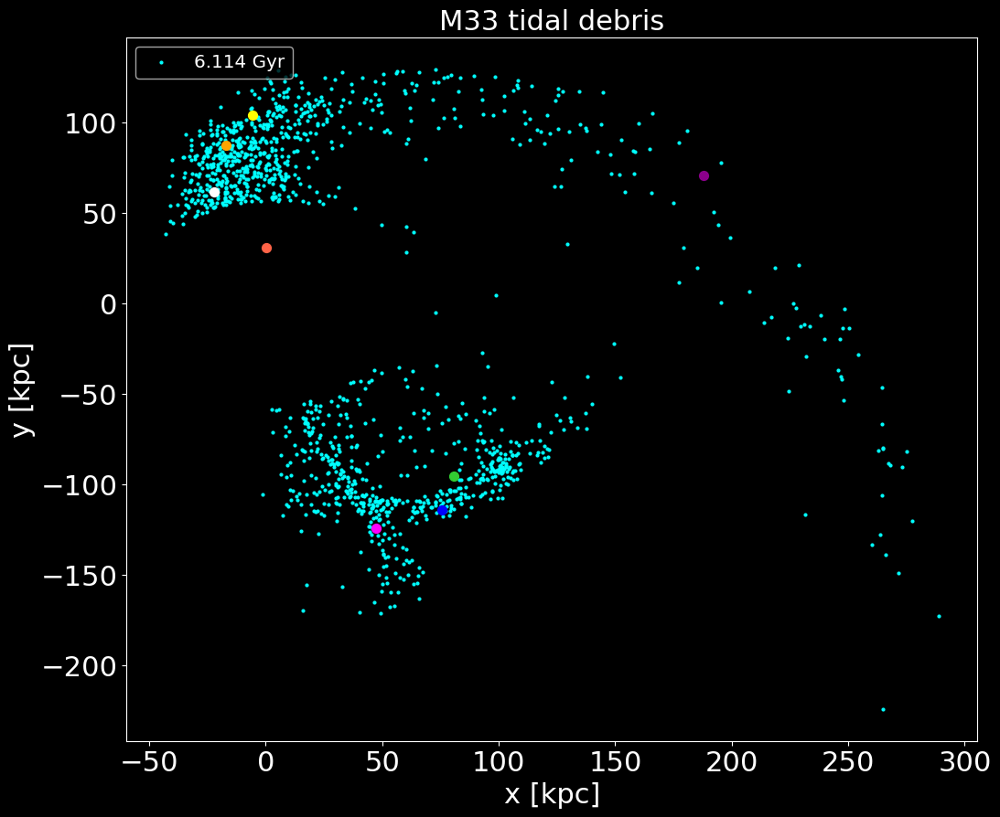

velocities: 100.80704818959833 133.61109464786222 135.54054573964206 386.0944934753667 218.09374571280125 286.21468646238264 270.6131310911575 273.15850249303975
positions: 63.17164813426986 73.30566670926606 88.24741972998417 108.30158053115798 128.25105787477935 148.5586379448923 168.06387686234063 198.15184193441146


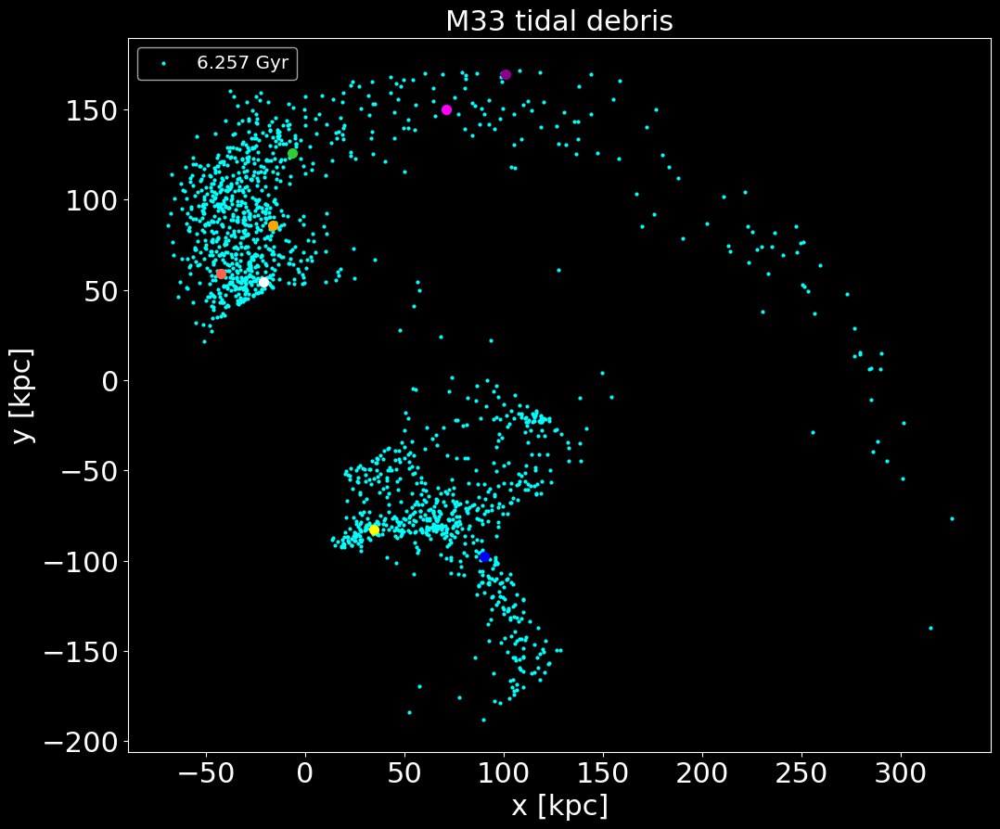

velocities: 108.1429955624501 456.6147977639358 133.04042061098767 171.86319956846202 209.66038474792992 228.7304404484895 205.96076978640858 291.24269264807316
positions: 57.59211141371707 67.52959970427781 82.54217193071675 102.5939253786987 122.68049154205407 142.5598859777883 162.5749010675021 192.5693549477694


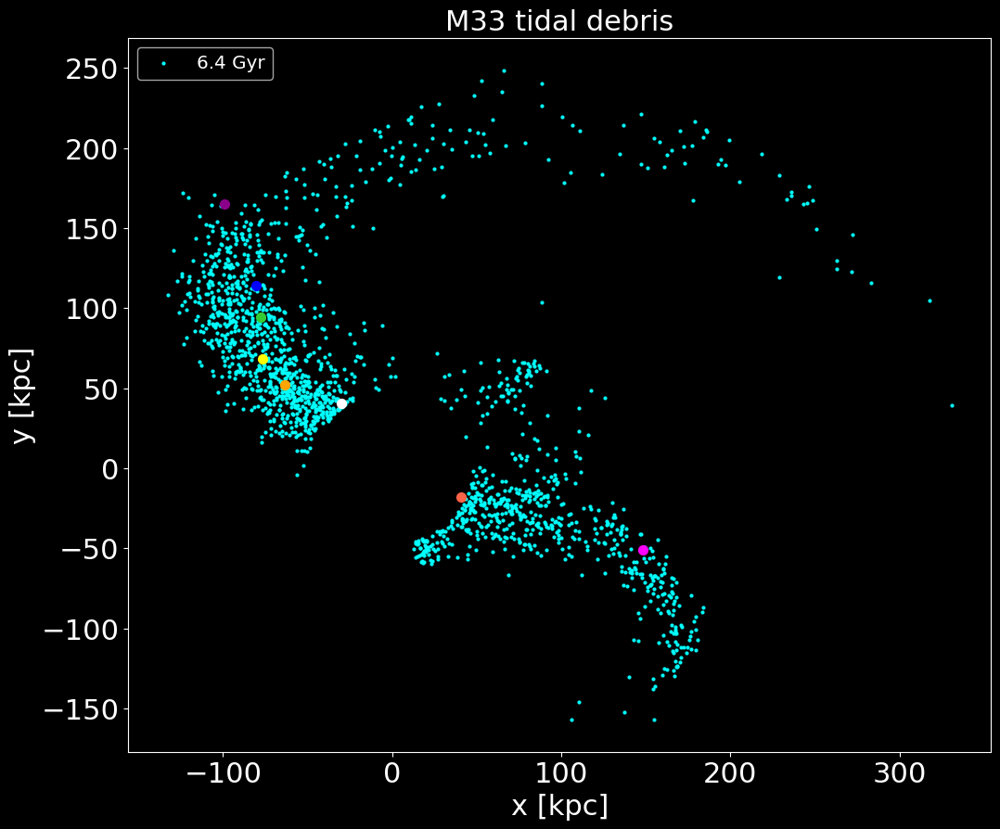

velocities: 447.28830658741794 465.5061023175099 158.8204054663317 167.87153868589516 212.88323381161325 160.477333290437 278.7729205210936 297.9170471445533
positions: 50.08620549662352 60.1075355819052 75.06786444944333 95.07627775717768 115.03901199597463 135.08731318425464 155.12257847241324 184.97829609013593


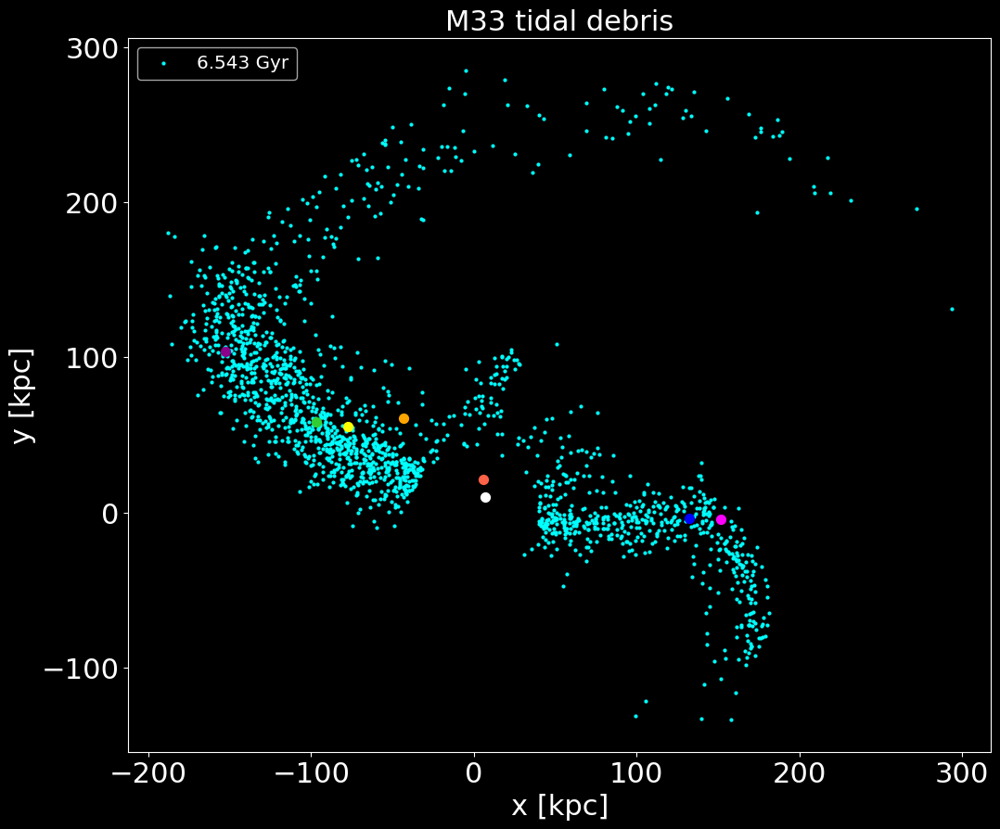

velocities: 118.47993640992553 170.1374371847948 222.23811888206757 191.45146003940528 252.58097922102127 340.6409850445746 302.89001324588105 310.4700216936411
positions: 41.40066507424729 51.43603206305965 66.44700955347803 86.46311041768043 106.44736589986623 126.35906566546778 146.36208788555868 176.42283256925674


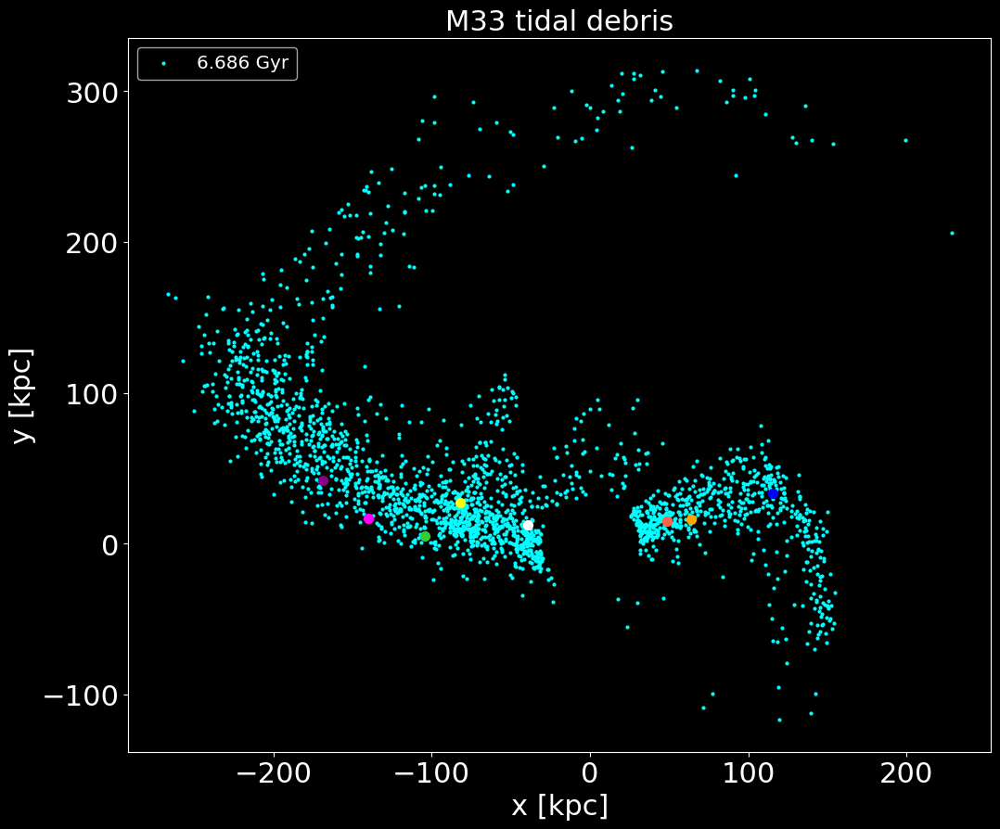

velocities: 114.48435278990574 221.4818668789346 165.47901942920134 190.78386013250702 302.70084219355914 253.14031113562294 455.40027810046405 308.87899912836417
positions: 42.035699944451984 52.07587802370691 66.93469187424411 86.90114491274323 107.06679217521183 126.96423071999452 147.0529451278008 177.04363036551186


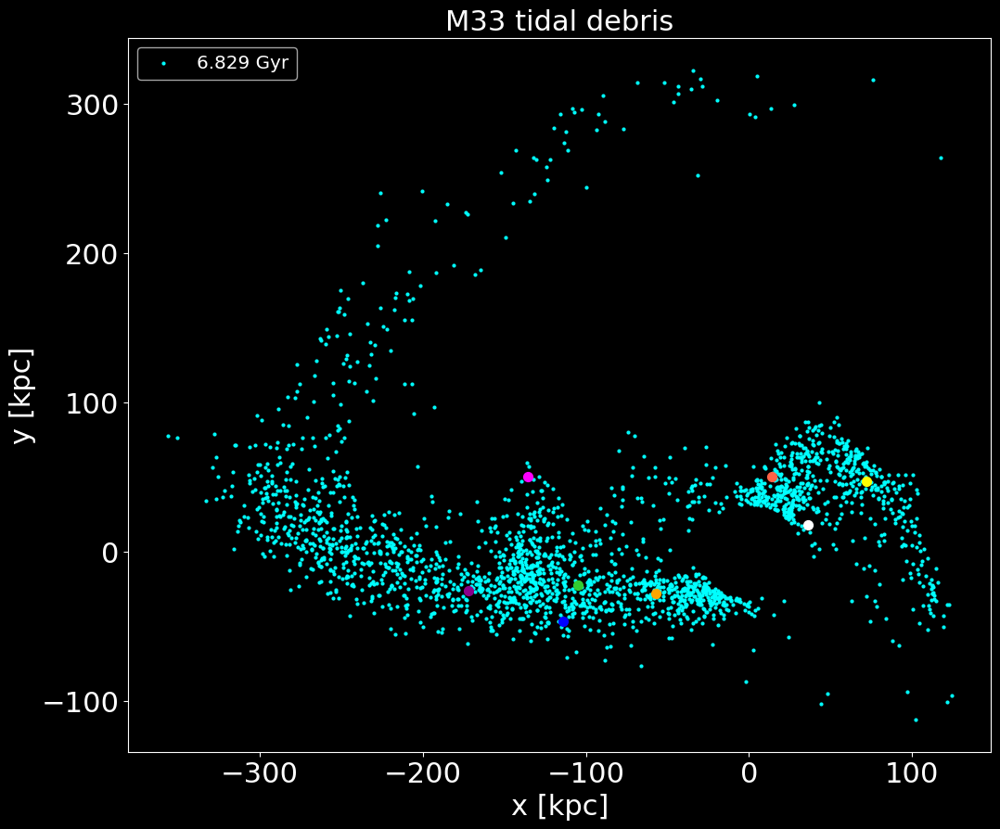

velocities: 198.76021578022096 211.07697413585876 233.1701076660557 209.10560344715776 267.85772413550075 287.7595433638996 393.81258871892356 313.643521414583
positions: 49.966163130463556 59.984907372188225 74.91279979042032 95.09490712514524 114.9548881249075 135.3750764023053 155.13873692169858 184.94204346835255


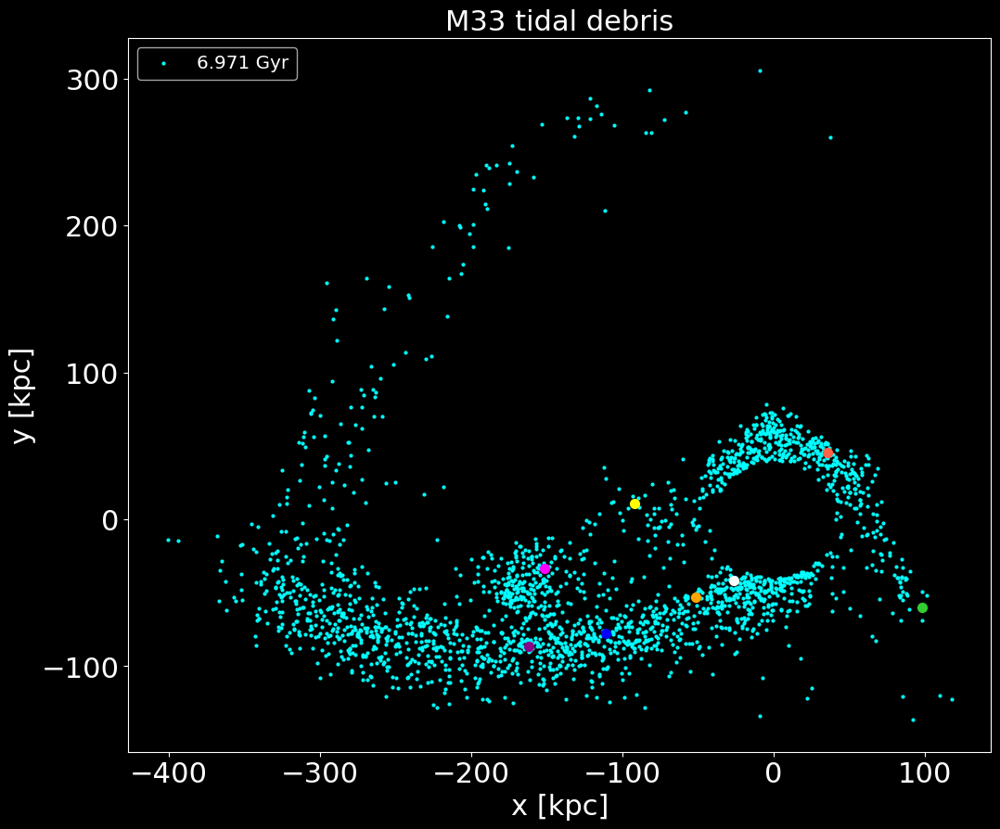

velocities: 168.31419606881056 201.87622288214132 265.6829927538645 282.78059913296744 206.20869814949612 317.28318365587864 304.93498372603955 165.4602093419744
positions: 58.1864103160214 68.17019833399416 83.22552557599141 103.2629571438374 123.14217756650238 142.98428585764242 162.93577298484823 193.21853134233785


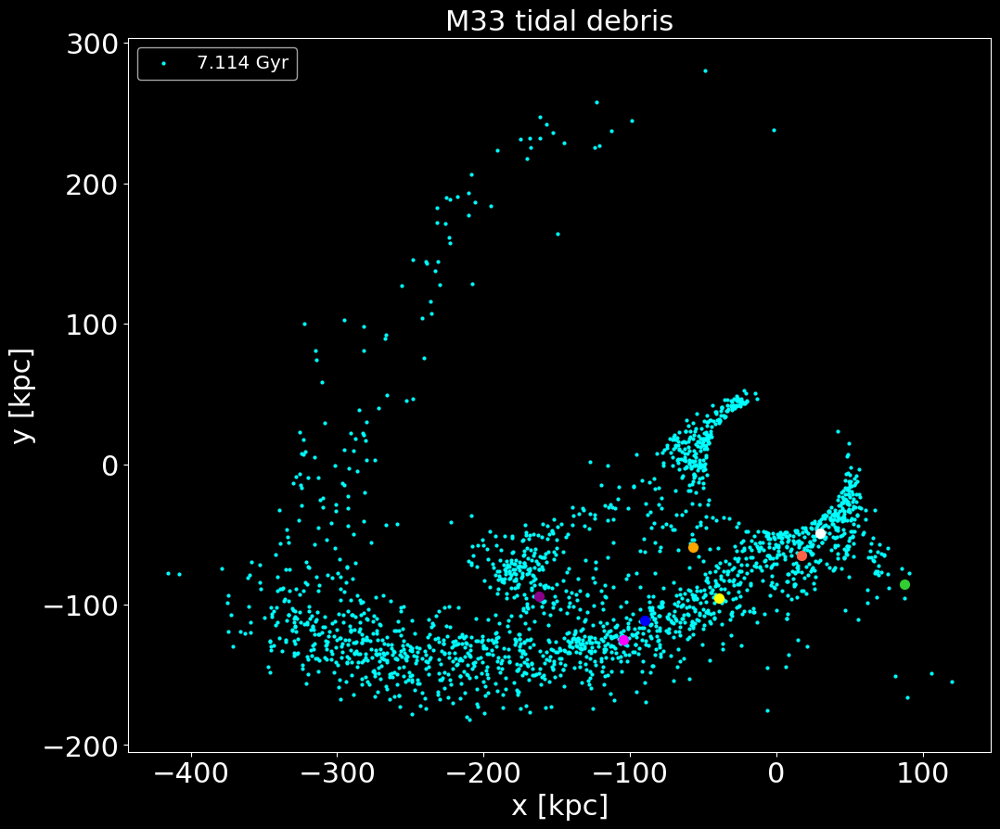

velocities: 267.5572017490092 270.5965764953615 209.48013198286847 252.38957201146405 139.78572851632748 326.52976645673516 310.9743670246305 305.55803756798804
positions: 64.06514161109769 74.05090681983576 89.06163445726784 109.1143637574357 129.02999323277515 149.1138928581103 169.03352481286072 199.0176639551374


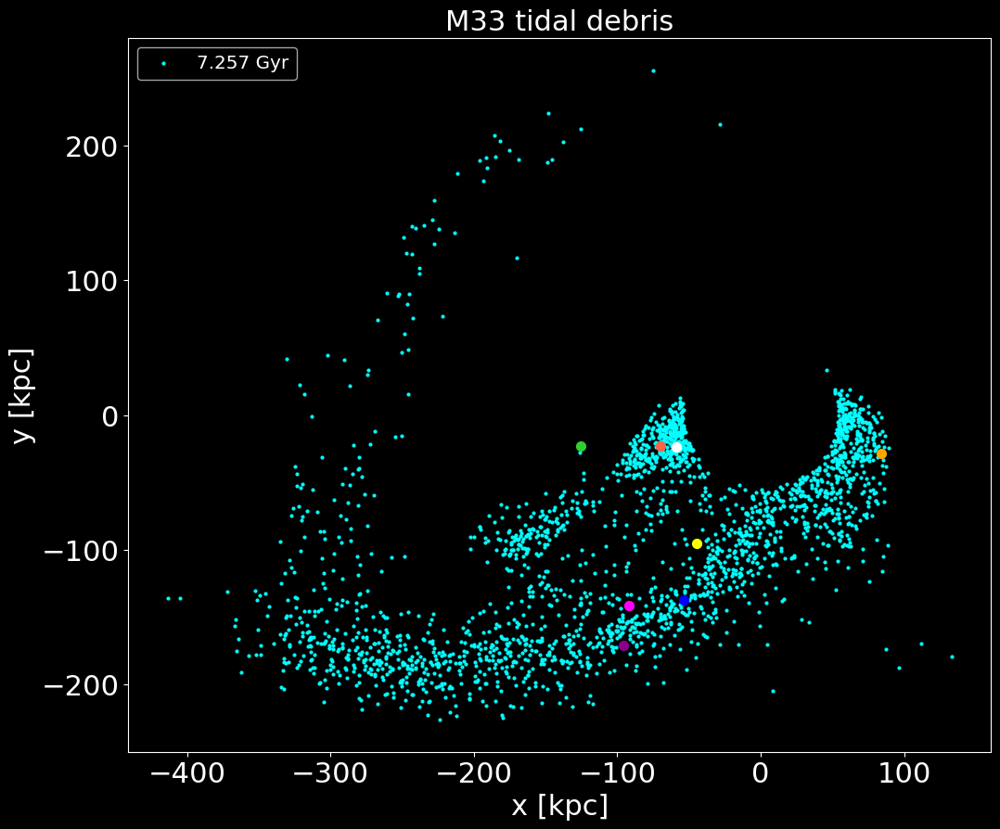

velocities: 188.0630409553137 149.19254370217735 473.3493414508992 240.99684102681599 236.33470538431294 317.86564691947194 348.5239353545176 359.42786043273
positions: 67.07351612581526 77.07888447584072 92.04427478121603 112.0642167008274 131.63273403071136 152.12948998541867 171.74730344797268 201.89207157342756


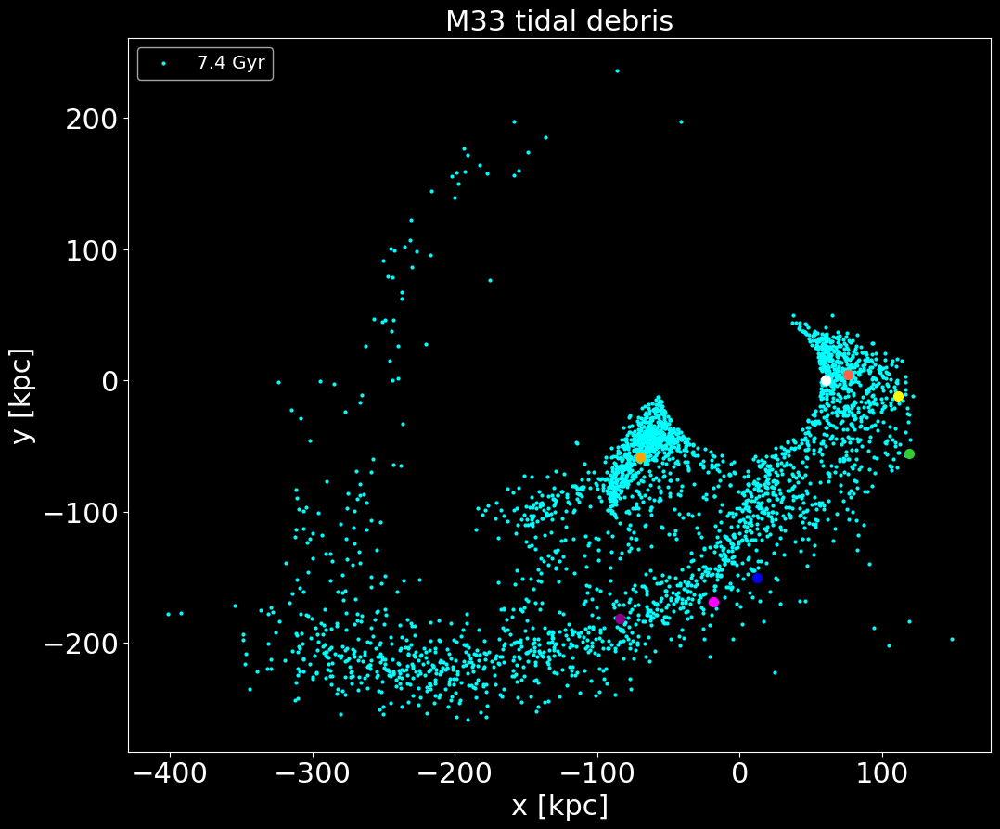

velocities: 139.18468303265269 160.18417423094579 339.5635128651635 216.51590534214802 399.7840284174444 332.53484563156684 409.1624125687622 225.1001681949838
positions: 67.4462906075642 77.47081823294755 92.44764007720048 112.40279729441791 132.39182523347128 152.36945326783845 172.31405105927956 202.52434808094065


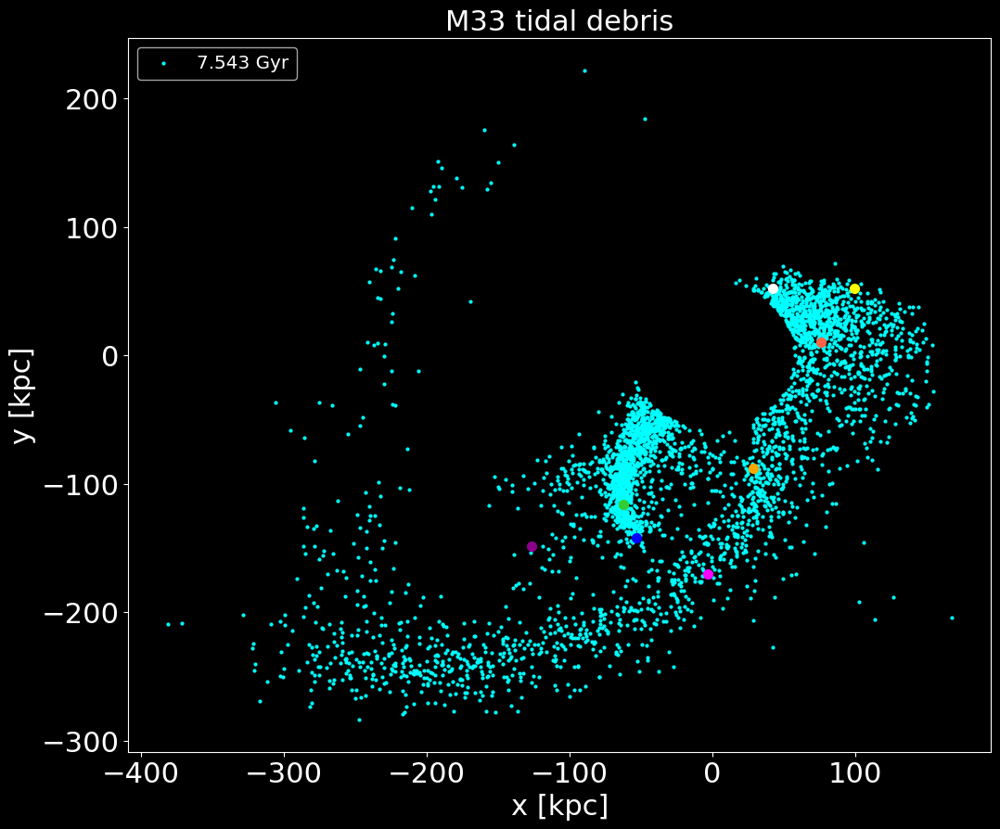

velocities: 146.96522119906464 170.59838462013641 317.3826945355402 226.336100685971 379.76698907700353 356.0117908769876 270.01573461600344 399.7529077661474
positions: 65.22751622651289 75.24096330011997 90.22101109564225 110.2338695902489 130.22858420442878 150.22602852229036 170.28119395834645 200.27828004638945


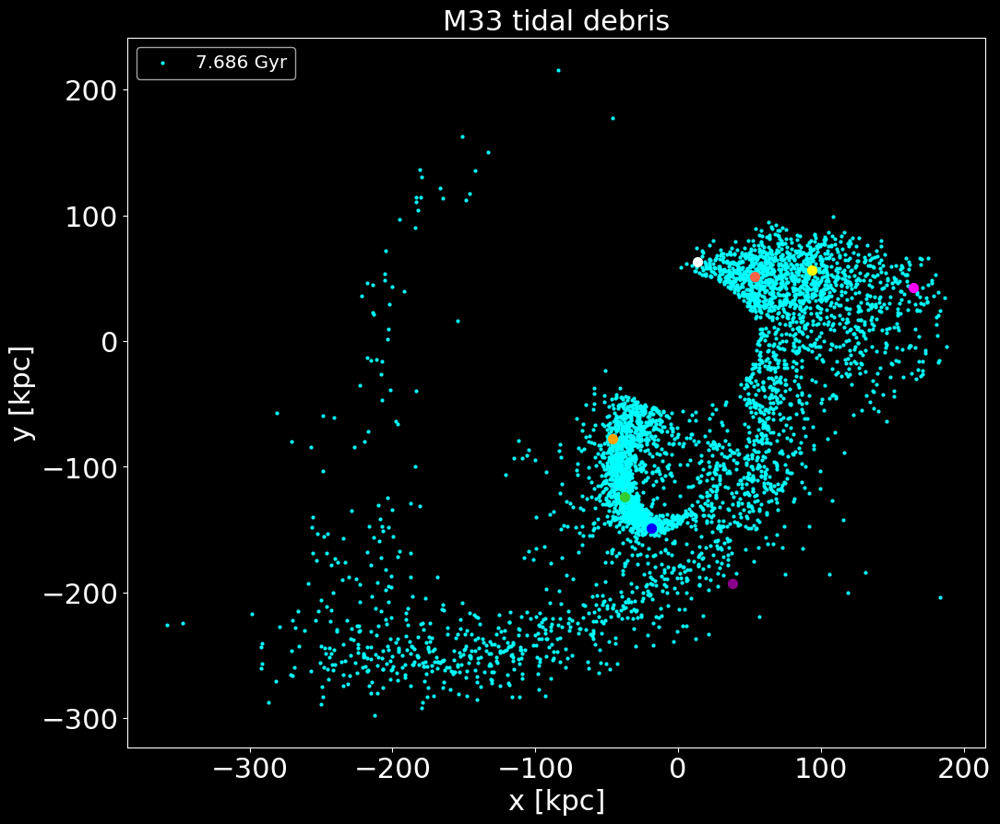

velocities: 109.39779251543425 138.14781903891532 237.9765965671835 393.58314694356517 245.25884156533485 508.1752580389958 271.494278653621 460.3771248726418
positions: 60.67282695581276 70.63810496523814 85.65473285131488 105.66125220117353 125.67660169975952 145.65769423610965 165.73123076764983 195.51719077919518


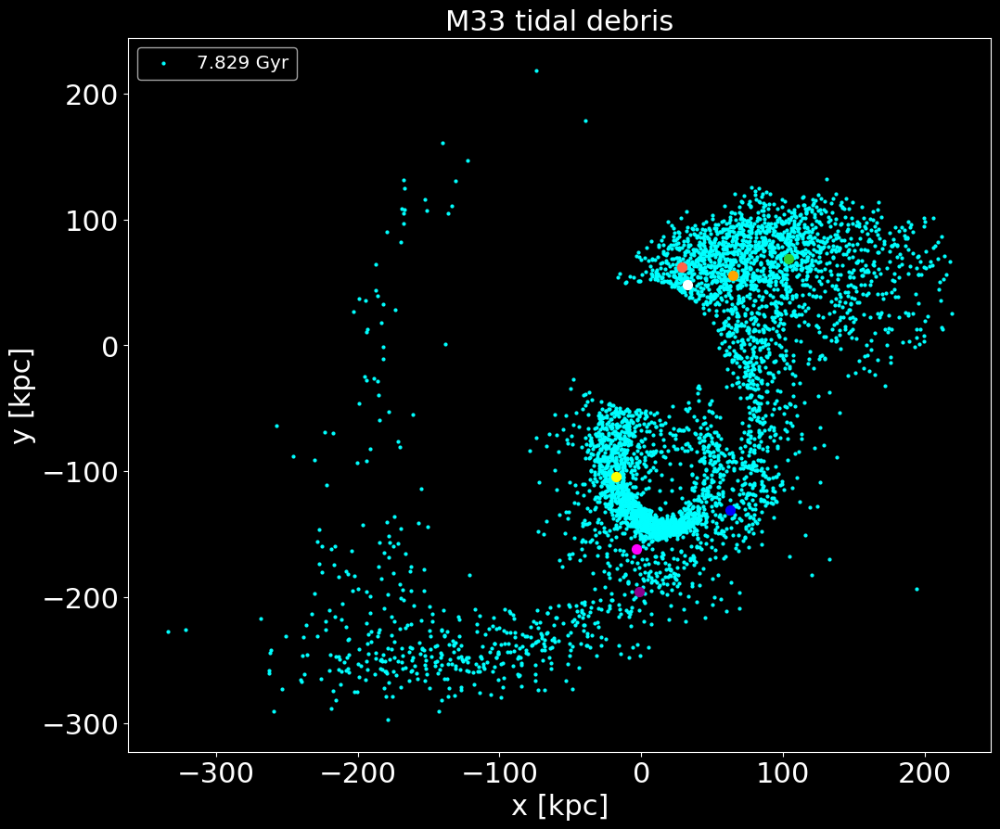

velocities: 97.59488188936959 154.7144541697381 397.92977147155 206.12356271277892 502.2954957407044 271.8620900019162 318.3810157423649 491.6867677025299
positions: 53.412293046545 63.48897878813298 78.48466129403884 98.4823945306977 118.51254503098353 138.50049698250186 158.5230308816356 188.53954305727194


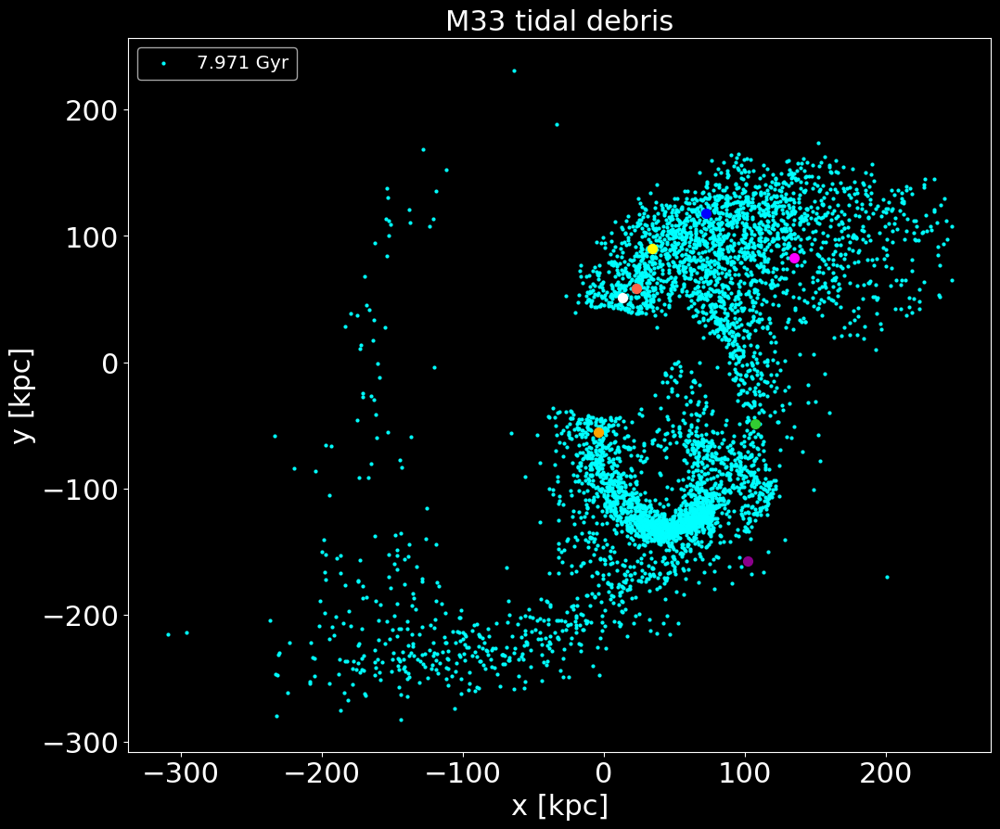

velocities: 136.64978541863871 391.60290036189724 162.73543498881858 184.24332977342763 364.0106845725823 292.44645538231435 281.9221010129394 339.41850663051656
positions: 44.48622448578884 54.51422387817698 69.3746629541362 89.44631073023638 109.47348148090478 129.49140284103808 149.48243227585007 179.4708242977671


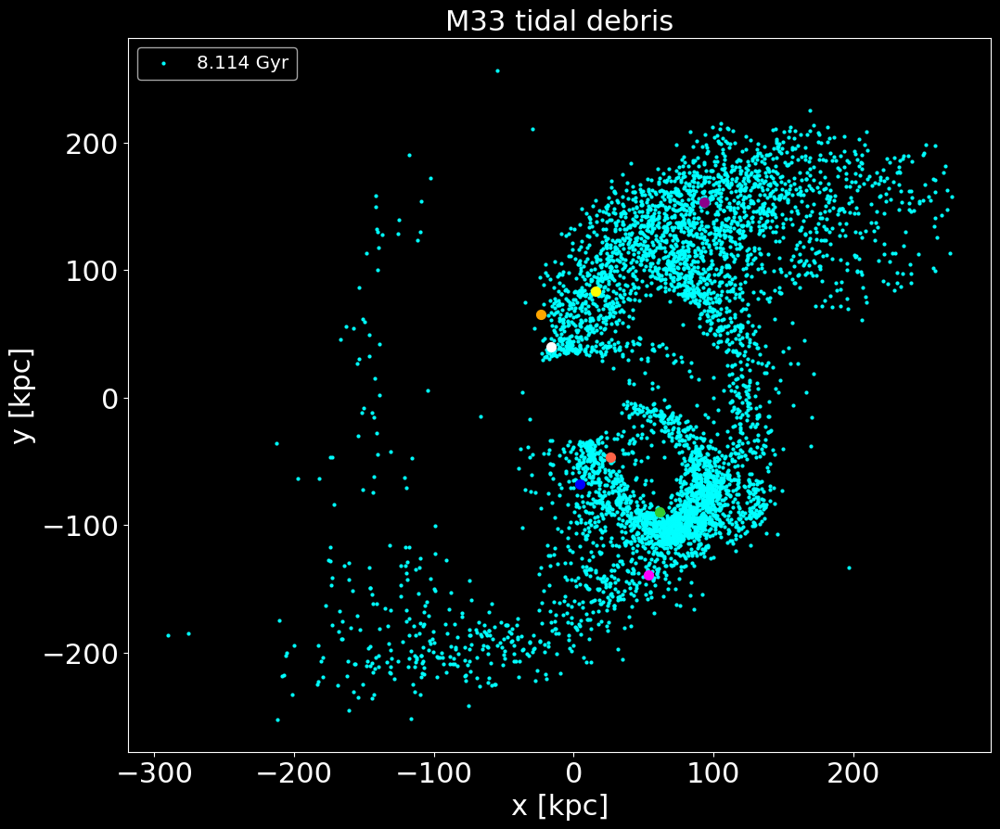

velocities: 625.2236213795829 435.8940910335904 621.7582996478615 345.5659331386125 167.91304143564906 291.0799779339005 589.8363117134194 344.71048008676786
positions: 38.2518895841761 48.20783684381617 63.24354539595325 83.22878318484538 103.2447972621381 123.26354920267387 143.27914289333287 173.31317311283638


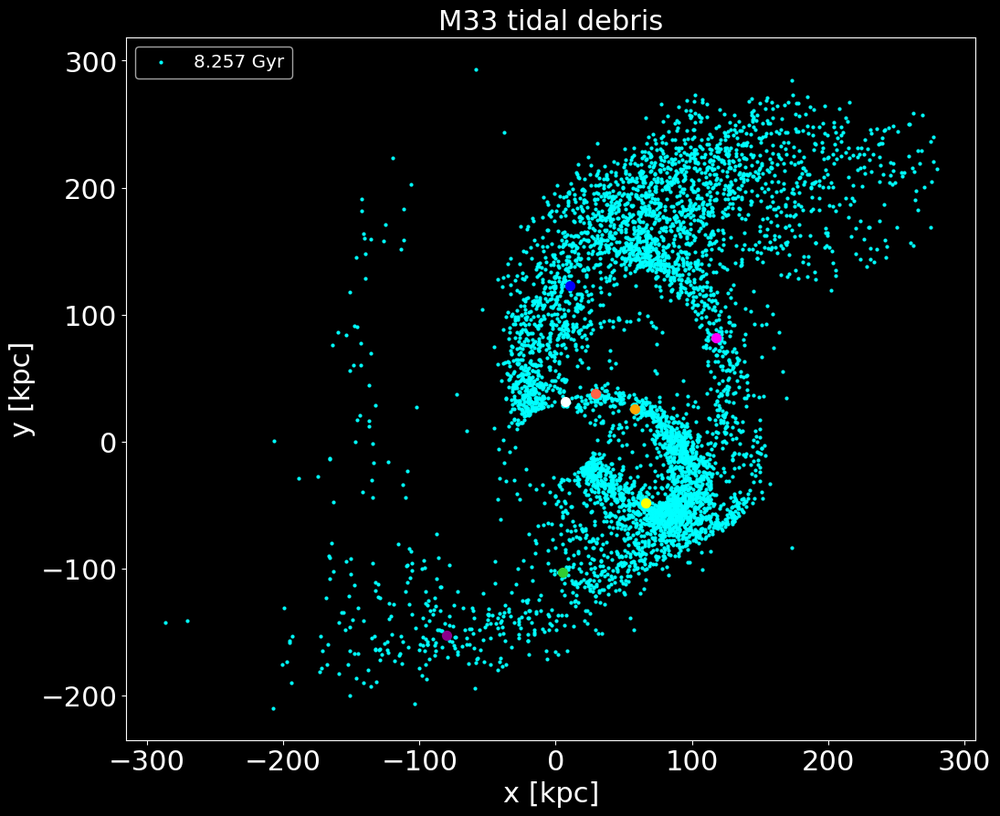

In [235]:
# # array of timeteps where streams evolve
tsteps = np.arange(288,588,10)

# define empty arrays of time and Jacobi radius values for plotting later
time = np.empty(len(tsteps), dtype='float')
Rj = np.empty(len(tsteps), dtype='float')

for i, step in enumerate(tsteps):# loop over numers in timestep array
    # create filename based on corresponding timestep
    if step < 10:
        ilbl = 'M33'+'_00'+str(step)+'.txt'
        ilbl31 = 'M31'+'_00'+str(step)+'.txt'
    elif step >= 10 and step < 100:
        ilbl = 'M33'+'_0'+str(step)+'.txt'
        ilbl31 = 'M31'+'_0'+str(step)+'.txt'
    else:
        ilbl = 'M33'+'_'+str(step)+'.txt'
        ilbl31 = 'M31'+'_'+str(step)+'.txt'

    filename = 'M33'+'/'+ilbl
    M31file = 'M31'+'/'+ilbl31

    # call Positions2D function for positions, velocities, and time
    rn, vn, dist, vel, t = Positions2D(filename)

    '''
    Jacobi radius code:
    '''
    # # distance between M31com and M33com
    COMM33 = CenterOfMass(filename,2)
    COMP_33 = COMM33.COM_P(0.1,4).value
    COMM31 = CenterOfMass(M31file,2)
    COMP_31 = COMM31.COM_P(0.1,2).value
    
    R = COMP_33-COMP_31
    R_mag = np.sqrt(R[0]**2+R[1]**2+R[2]**2)
    
    # find total mass of M31 within the distance between M31 and M33 centers of mass
    M31p = MassProfile(M31file,step)
    m31 = M31p.MassEnclosedTotal(np.array(R_mag))
    # find total mass of M33
    m33 = Totmass(filename)

    rj = JacobiR(m31, m33, R_mag).value

    time[i] = t
    Rj[i] = rj

    cyl_r = np.sqrt(rn[:,0]**2 + rn[:,1]**2) # radial

    index = np.where(cyl_r >= rj)

    # define indexes to select for particles at different radii 
    bin0 = list(dist).index(find_nearest(dist,rj+10))
    bin1 = list(dist).index(find_nearest(dist,rj+20))
    bin2 = list(dist).index(find_nearest(dist,rj+35))
    bin3 = list(dist).index(find_nearest(dist,rj+55))
    bin4 = list(dist).index(find_nearest(dist,rj+75))
    bin5 = list(dist).index(find_nearest(dist,rj+95))
    bin6 = list(dist).index(find_nearest(dist,rj+115))
    bin7 = list(dist).index(find_nearest(dist,rj+145))

    # define velocities of the particles at the position indexes above
    vbin0 = vel[bin0]
    vbin1 = vel[bin1] 
    vbin2 = vel[bin2]
    vbin3 = vel[bin3] 
    vbin4 = vel[bin4] 
    vbin5 = vel[bin5] 
    vbin6 = vel[bin6] 
    vbin7 = vel[bin7] 
    
    # print velocities and positions of select particle along both streams
    # so they can be used to find the average velocities of each corresponding stream
    print('velocities:',vbin0,vbin1,vbin2,vbin3,vbin4,vbin5,vbin6,vbin7)
    print('positions:',dist[bin0],dist[bin1],dist[bin2],dist[bin3],dist[bin4],dist[bin5],dist[bin6],dist[bin7])

    # plot frames with highlighted selected stream particles
    fig, ax= plt.subplots(figsize=(12, 10))
    plt.style.use('dark_background')
    
    plt.scatter(rn[index[0], 0], rn[index[0], 1], color='cyan', s=4, label=f"{np.round(t,3)} Gyr")

    plt.scatter(rn[bin0, 0], rn[bin0, 1], color='white', s=50)
    plt.scatter(rn[bin1, 0], rn[bin1, 1], color='tomato', s=50)
    plt.scatter(rn[bin2, 0], rn[bin2, 1], color='orange', s=50)
    plt.scatter(rn[bin3, 0], rn[bin3, 1], color='yellow', s=50)
    plt.scatter(rn[bin4, 0], rn[bin4, 1], color='limegreen', s=50)
    plt.scatter(rn[bin5, 0], rn[bin5, 1], color='blue', s=50)
    plt.scatter(rn[bin6, 0], rn[bin6, 1], color='magenta', s=50)
    plt.scatter(rn[bin7, 0], rn[bin7, 1], color='darkmagenta', s=50)
    

    #Add axis labels
    plt.xlabel('x [kpc]', fontsize=22)
    plt.ylabel('y [kpc]', fontsize=22)

    # #set axis limits
    # plt.ylim(-250,250)
    # plt.xlim(-350,350)

    plt.legend(loc='upper left',fontsize='x-large')
    plt.title('M33 tidal debris',fontsize=22)

    #adjust tick label font size
    label_size = 22
    matplotlib.rcParams['xtick.labelsize'] = label_size 
    matplotlib.rcParams['ytick.labelsize'] = label_size

    # # Save file
    # if i < 10:
    #     plt.savefig('00'+str(i)+'Debris.png')
    # elif 10 <= i < 100:
    #     plt.savefig('0'+str(i)+'Debris.png')
    # else:
    #     plt.savefig(str(i)+'Debris.png')
        
    plt.show()


# find velocity of stream particles of given radii to see how the velocity gradient of trailing versus leading arm 
which is losing energy, which is gaining energy (leading should be losing energy i think perhaps... because trailing is being consistently dragged around)

lower mass stellite galaxies like M33 hang around and stay orbiting for longer because dynamical friction scales with mass, as opposed to M31 and MW which are more massive galaxies that merge within just one orbit

# Step 5: Make relevant final plots

In [ ]:
'''
average velocity of stream particles versus time
'''

fig, ax= plt.subplots(figsize=(8, 8))
plt.style.use('default')

plt.plot(time,Vavg_streams,linewidth=4, color='dodgerblue')

#Add axis labels
plt.xlabel('time [Gyr]', fontsize=22)
plt.ylabel('v [km/s]', fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.savefig('VvsT.png')

plt.show()

In [241]:
# average velocity magnitude of trailing stream at each timestep
trailing = np.array([0,0,0,206.5, 165.3, 180.9, 198.1, 226.01, 283.1, 274.55, 265.7, 262.5, 248.5, 221.9, 212.2, 203.05, 180.9, 255.4, 214.49, 237.2, 273.4, 253.4, 257.6, 241, 284.7, 313.1, 349.18, 323.2, 261.8, 440.5])

# average velocity magnitude of leading stream at each timestep
leading = np.array([0,0,0,165.48, 215.1, 215.5, 183.5, 307.50, 286.4, 225.9, 354.9, 427.35, 338.1, 200, 267.3, 336.2, 331.3, 219.7, 255.4, 206.2, 239.5, 215.6, 205.2, 473.3, 366.15, 336.7, 332.6, 450.1, 328.2, 483.7])


In [434]:
# find overall average velocity through time of each stream

leading_avg = np.mean(leading) # leading stream
print(leading_avg)

trailing_avg = np.mean(trailing) # trailing stream
print(trailing_avg)

265.56266666666664
227.80600000000004


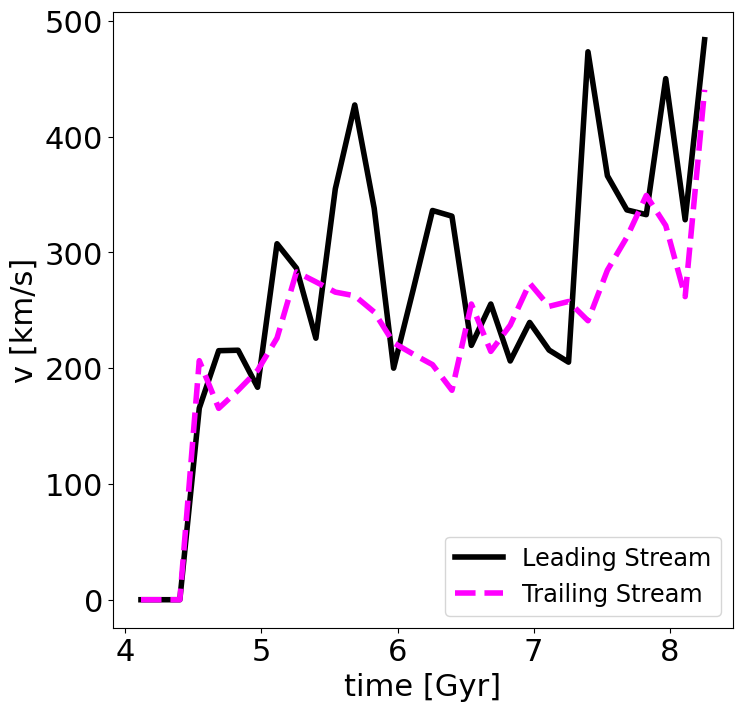

In [429]:

# plotting the average velocity magnitudes of both streams over time

fig, ax= plt.subplots(figsize=(8, 8))
plt.style.use('default')

plt.plot(time,leading,linewidth=4, color='black', label= 'Leading Stream')
plt.plot(time,trailing,linewidth=4, color='magenta', linestyle='--', label='Trailing Stream')

# adjust tick size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

#Add axis labels
plt.xlabel('time [Gyr]', fontsize=22)
plt.ylabel('v [km/s]', fontsize=22)

plt.legend(loc='lower right',fontsize='xx-large')

plt.savefig('Vstreams.png')

plt.show()

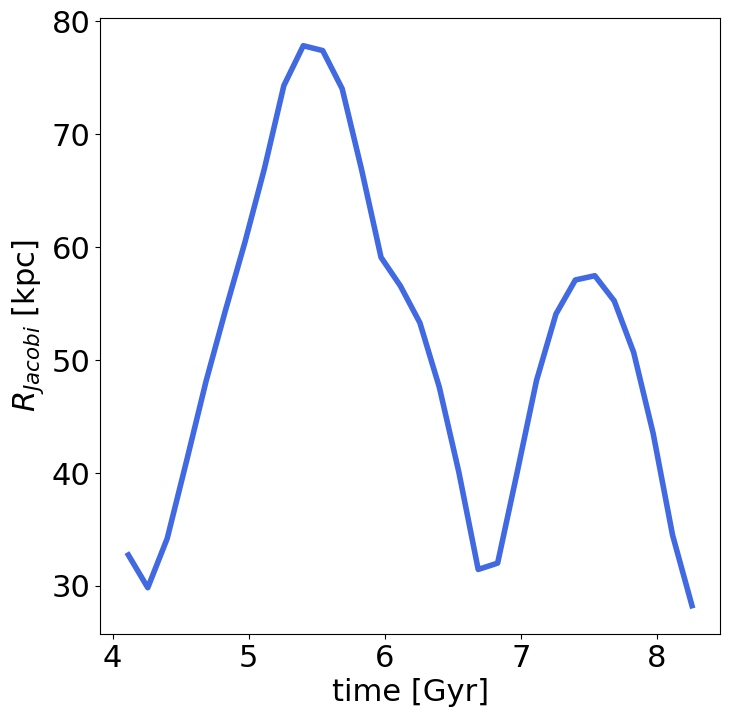

In [431]:
'''
Jacobi radius versus time
'''

fig, ax= plt.subplots(figsize=(8, 8))

plt.plot(time,Rj,linewidth=4, color='royalblue')

#Add axis labels
plt.xlabel('time [Gyr]', fontsize=22)
plt.ylabel(r'$R_{Jacobi}$ [kpc]', fontsize=22)

#adjust tick label font size
label_size = 22
matplotlib.rcParams['xtick.labelsize'] = label_size 
matplotlib.rcParams['ytick.labelsize'] = label_size

plt.style.use('default')

plt.savefig('RjvsT.png')

plt.show()